# Проектная работа. Рынок заведений общественного питания Москвы. Для Shut Up and Take My Money

**Описание проекта:**

Заказчики попросили провести исследования рынка общественного питание Москвы, но еще не знает какой тип заведения открывать. Будет ли выгоднее, например, открыть кафе или ресторан? Получить теоретичсекий ответ на разные случаи. Выявить общие закономерности рынка, которые помогут менеджерам лучше понять и вернее приянть решение.

**Задание**: Провести исследование рынка общественного питания Москвы

**Цели исследования:**
1) Провести исследование анализа данных рынка общественного питания в Москве;

2) Провести исследования кофеен в Москве;

3) Найти интересные особенности и презентовать полученные результаты.

**Требование к отчету:**
* Более информативная интерпритация результатов;
* много иллюстративных элементов: графиков и таблиц.

**Описание данных:**

Дан 1 датасет - /datasets/logs_exp.csv, который содержит логи событий пользователей с его айди, типом события, группой и временем:

Файл moscow_places.csv:

1) **name** — название заведения;

2) **address** — адрес заведения;

3) **category** — категория заведения, например «кафе», «пиццерия» или «кофейня»;

4) **hours** — информация о днях и часах работы;

5) **lat** — широта географической точки, в которой находится заведение;

6) **lng** — долгота географической точки, в которой находится заведение;

7) **rating** — рейтинг заведения по оценкам пользователей в Яндекс Картах (высшая оценка — 5.0);

8) **price** — категория цен в заведении, например «средние», «ниже среднего», «выше среднего» и так далее;

9) **avg_bill** — строка, которая хранит среднюю стоимость заказа в виде диапазона, например **:**

    * «Средний счёт: 1000–1500 ₽»;
    * «Цена чашки капучино: 130–220 ₽»;
    * «Цена бокала пива: 400–600 ₽».

    и так далее;

10) **middle_avg_bill** — число с оценкой среднего чека, которое указано только для значений из столбца avg_bill, начинающихся с подстроки «Средний счёт»:

    * Если в строке указан ценовой диапазон из двух значений, в столбец войдёт медиана этих двух значений.
    * Если в строке указано одно число — цена без диапазона, то в столбец войдёт это число.
    * Если значения нет или оно не начинается с подстроки «Средний счёт», то в столбец ничего не войдёт.

11) **middle_coffee_cup** — число с оценкой одной чашки капучино, которое указано только для значений из столбца avg_bill, начинающихся с подстроки «Цена одной чашки капучино»:

    * Если в строке указан ценовой диапазон из двух значений, в столбец войдёт медиана этих двух значений.
    * Если в строке указано одно число — цена без диапазона, то в столбец войдёт это число.
    * Если значения нет или оно не начинается с подстроки «Цена одной чашки капучино», то в столбец ничего не войдёт.

12) **chain** — число, выраженное 0 или 1, которое показывает, является ли заведение сетевым (для маленьких сетей могут встречаться ошибки):

    - 0 — заведение не является сетевым
    - 1 — заведение является сетевым

13) **district** — административный район, в котором находится заведение, например Центральный административный округ;

14) **seats** — количество посадочных мест.

**Проект состоит из 4 частей:**

1) Выгрузка и изучение общей информации о данных;

2) Предобработка и подготовка к анализу;

3) Иследование рынка общественного питания Москвы;

4) Анализ кофеен для возможного открытия;

5) Общий вывод;

6) Презентация.

## Выгрузим датасет и изучим общую информацию о нем:

Подключим библиотки h3 и geojson:

In [2]:
!pip install h3
!pip install geojson

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.1/1.1 MB 14.5 MB/s eta 0:00:00


Подключим основые библиотки: из них pandas, математические, статистические и графические:

In [3]:
import pandas as pd
import matplotlib
import matplotlib.pyplot as plt
import seaborn as sns
from sqlalchemy import create_engine
import numpy as np
import scipy.stats as st
import statsmodels.api as sm
from scipy. stats import lognorm
import math
import plotly.express as px
from plotly import graph_objects as go
from folium import Map, Choropleth, Marker
from folium.plugins import MarkerCluster
import matplotlib.ticker as ticker
from matplotlib.ticker import NullFormatter, FormatStrFormatter
import folium
from geojson import Feature, Point, FeatureCollection
import h3
import json
import seaborn.categorical
from IPython.display import Markdown
import nbformat
import re
import gdown


import warnings
warnings.filterwarnings('ignore')

from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [4]:
def generate_table_of_contents(notebook_path):
    notebook_url = 'https://drive.google.com/uc?id=' + notebook_path.split('/')[-2]
    gdown.download(notebook_url, 'notebook.ipynb', quiet=True)

    with open('notebook.ipynb', 'r', encoding='utf-8') as file:
        notebook = nbformat.read(file, nbformat.NO_CONVERT)

    table_of_contents = []
    heading_numbers = [0, 0, 0, 0, 0, 0]  # Начальные значения номеров для разных уровней заголовков

    for cell in notebook['cells']:
        if cell['cell_type'] == 'markdown':
            source = cell['source']
            headers = re.findall(r'^(#+)\s+(.*)$', source, flags=re.MULTILINE)

            for header in headers:
                level = len(header[0])
                title = header[1].strip()

                link = '-'.join(re.findall(r'\w+', title.lower()))
                indentation = '&nbsp;' * 2 * (level - 1)
                line_break = '\n' + '&nbsp;' * 2 * level

                heading_numbers[level - 1] += 1
                heading_number_str = '.'.join(str(num) for num in heading_numbers[:level])

                colab_link = notebook_path + f'#scrollTo={link}'
                table_of_contents.append(f'{line_break}- {heading_number_str} {title}')

    markdown_output= '\n'.join(table_of_contents)
    display(Markdown(markdown_output))


# Укажите ссылку на ваш файл на Google Диске
notebook_path = 'https://drive.google.com/file/d/1eQ3vkeeS3M-HGdOZFUd62m_rvsFhkxm_/view?usp=sharing'

# Генерирование оглавления
table_of_contents = generate_table_of_contents(notebook_path)

# Отображение оглавления



&nbsp;&nbsp;- 1 Проектная работа. Рынок заведений общественного питания Москвы. Для Shut Up and Take My Money

&nbsp;&nbsp;&nbsp;&nbsp;- 1.1 Выгрузим датасет и изучим общую информацию о нем:

&nbsp;&nbsp;&nbsp;&nbsp;- 1.2 Предобработка данных:

&nbsp;&nbsp;&nbsp;&nbsp;- 1.3 Анализ данных:

&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;- 1.3.1 **Далее рассмотрим категории заведений:**

&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;- 1.3.2 Исследуем распределение количества посадочных мест по категориям:

&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;- 1.3.3 **Далее рассмотри распределение сетевых и несетвых заведений.**

&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;- 1.3.4 Рассмотрим топ 15 самый популярных заведений:

&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;- 1.3.5 **Далее рассмотрим информацию об округах Москвы:**

&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;- 1.3.6 Визуализируем распределение средних рейтингов  по категориям:

&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;- 1.3.7 Построим хороплет среднего рейтинга по округам Москвы:

&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;- 1.3.8 Отобразим все заведения общепита Москвы с их средним рейтингом на карте с кластеризацией:

&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;- 1.3.9 **Проанализируем самые популярные улицы (15 лидеров ко количеству заведений на них).**

&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;- 1.3.10 **Пронализируем улицы с 1 заведением общепита.**

&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;- 1.3.11 **Проанализируем как распределяется и как зависит средний чек по округам Москвы:**

&nbsp;&nbsp;&nbsp;&nbsp;- 1.4 Анализ открытия кофейни:

&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;- 1.4.12 Проанализируем как распределяется кофейни по районам:

&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;- 1.4.13 График работы кофеен:

&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;- 1.4.14 Ислледуем рейтинги кофеен. Рассмотрим их распределение.

&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;- 1.4.15 Выясним на какую стоимость чашки капучино стоит ориентироваться при открытии:

&nbsp;&nbsp;&nbsp;&nbsp;- 1.5 ВЫВОД:

&nbsp;&nbsp;- 2 ПРЕЗЕНТАЦИЯ

Выгрузим данные:

In [ ]:
data=pd.read_csv('https://code.s3.yandex.net/datasets/moscow_places.csv')
data

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats
0,WoWфли,кафе,"Москва, улица Дыбенко, 7/1",Северный административный округ,"ежедневно, 10:00–22:00",55.878494,37.478860,5.0,NaN,NaN,NaN,NaN,0,NaN
1,Четыре комнаты,ресторан,"Москва, улица Дыбенко, 36, корп. 1",Северный административный округ,"ежедневно, 10:00–22:00",55.875801,37.484479,4.5,выше среднего,Средний счёт:1500–1600 ₽,1550.0,NaN,0,4.0
2,Хазри,кафе,"Москва, Клязьминская улица, 15",Северный административный округ,"пн-чт 11:00–02:00; пт,сб 11:00–05:00; вс 11:00...",55.889146,37.525901,4.6,средние,Средний счёт:от 1000 ₽,1000.0,NaN,0,45.0
3,Dormouse Coffee Shop,кофейня,"Москва, улица Маршала Федоренко, 12",Северный административный округ,"ежедневно, 09:00–22:00",55.881608,37.488860,5.0,NaN,Цена чашки капучино:155–185 ₽,NaN,170.0,0,NaN
4,Иль Марко,пиццерия,"Москва, Правобережная улица, 1Б",Северный административный округ,"ежедневно, 10:00–22:00",55.881166,37.449357,5.0,средние,Средний счёт:400–600 ₽,500.0,NaN,1,148.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8401,Суши Мания,кафе,"Москва, Профсоюзная улица, 56",Юго-Западный административный округ,"ежедневно, 09:00–02:00",55.670021,37.552480,4.4,NaN,NaN,NaN,NaN,0,86.0
8402,Миславнес,кафе,"Москва, Пролетарский проспект, 19, корп. 1",Южный административный округ,"ежедневно, 08:00–22:00",55.640875,37.656553,4.8,NaN,NaN,NaN,NaN,0,150.0
8403,Самовар,кафе,"Москва, Люблинская улица, 112А, стр. 1",Юго-Восточный административный округ,"ежедневно, круглосуточно",55.648859,37.743219,3.9,NaN,Средний счёт:от 150 ₽,150.0,NaN,0,150.0
8404,Чайхана Sabr,кафе,"Москва, Люблинская улица, 112А, стр. 1",Юго-Восточный административный округ,"ежедневно, круглосуточно",55.648849,37.743222,4.2,NaN,NaN,NaN,NaN,1,150.0


In [ ]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8406 entries, 0 to 8405
Data columns (total 14 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   name               8406 non-null   object 
 1   category           8406 non-null   object 
 2   address            8406 non-null   object 
 3   district           8406 non-null   object 
 4   hours              7870 non-null   object 
 5   lat                8406 non-null   float64
 6   lng                8406 non-null   float64
 7   rating             8406 non-null   float64
 8   price              3315 non-null   object 
 9   avg_bill           3816 non-null   object 
 10  middle_avg_bill    3149 non-null   float64
 11  middle_coffee_cup  535 non-null    float64
 12  chain              8406 non-null   int64  
 13  seats              4795 non-null   float64
dtypes: float64(6), int64(1), object(7)
memory usage: 919.5+ KB


Изменим тип данных в колисетве посадочных мест на целочисленный тип данных - Int64:

In [ ]:
data['seats']=pd.array(data['seats'], dtype="Int64")

In [ ]:
print('Тип данных в каждом столбце приведен в таблице:')
pd.DataFrame({'dtype':data.dtypes})

Тип данных в каждом столбце приведен в таблице:


,dtype
name,object
category,object
address,object
district,object
hours,object
lat,float64
lng,float64
rating,float64
price,object
avg_bill,object


Не стоит менять тип данных кроме того что сделанно выше.

In [ ]:
data.head(2)

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats
0,WoWфли,кафе,"Москва, улица Дыбенко, 7/1",Северный административный округ,"ежедневно, 10:00–22:00",55.878494,37.478860,5.0,NaN,NaN,NaN,NaN,0,<NA>
1,Четыре комнаты,ресторан,"Москва, улица Дыбенко, 36, корп. 1",Северный административный округ,"ежедневно, 10:00–22:00",55.875801,37.484479,4.5,выше среднего,Средний счёт:1500–1600 ₽,1550.0,NaN,0,4


In [ ]:
print('Наш датасет обладает следующими характеристиками:')
print(' * Количество строк:',data.shape[0])
print(' * количество столбцов:',data.shape[1])


Наш датасет обладает следующими характеристиками:
 * Количество строк: 8406
 * количество столбцов: 14



Подписывали текстом получившиеся расчеты

</div>

In [ ]:
round(data.describe(),2)

,lat,lng,rating,middle_avg_bill,middle_coffee_cup,chain,seats
count,8406.00,8406.00,8406.00,3149.00,535.00,8406.00,4795.0
mean,55.75,37.61,4.23,958.05,174.72,0.38,108.42
std,0.07,0.10,0.47,1009.73,88.95,0.49,122.83
min,55.57,37.36,1.00,0.00,60.00,0.00,0.0
25%,55.71,37.54,4.10,375.00,124.50,0.00,40.0
50%,55.75,37.61,4.30,750.00,169.00,0.00,75.0
75%,55.80,37.66,4.40,1250.00,225.00,1.00,140.0
max,55.93,37.87,5.00,35000.00,1568.00,1.00,1288.0


In [ ]:
print('В датасете',data.shape[0],'заведений.')
print('В датасете',data['name'].nunique(),'уникальных заведений общепита.')
print('Всего сетей и компаний не объединенных в сети:',data.loc[data['chain']==1,'name'].nunique()
      +data.loc[data['chain']==0].shape[0])

В датасете 8406 заведений.
В датасете 5614 уникальных заведений общепита.
Всего сетей и компаний не объединенных в сети: 5963


**ВЫВОД:**

**Значение столбцов с name по hours, а также price и avg_bill - хранят тип object - строковой тип. hours хранит словесное описание графика работы. price хранит словесную категорию заведения по тому высокая ли цена. lat, lng и rating, а так же middle_avg_bill и middle_coffee_cup - тип float. Рейтинг - оценка заведения, представленная в виде десятичной дроби до 5.0. Был изменен тип данных у столбца seats с float на int так как количество сидений может быть только целым числом.**

**В датасете 8 406 заведений и 5 483 заведений с уникальными названиями. НО всего сетей и компаний не объединенных в сети 5963.**

_________

## Предобработка данных:

In [ ]:
print('В датасете при стандартной проверке',data.duplicated().sum(),'дубликатов')

В датасете при стандартной проверке 0 дубликатов


In [ ]:
data.shape[0]==data[['name','lat','lng']].drop_duplicates()\
.shape[0]==data[['name','address']].\
drop_duplicates().shape[0]

True

In [ ]:
data.shape[0]

8406

При проверке дубликатов по нескольким важным строкам: таким как название и координаты, и название и адрес, далее при их сбросе количество строк не уменьшилось. Значит проверенные пары не являются дубликатами.

In [ ]:
data.query('chain==1').shape[0]

3205

In [ ]:
print('Количество уникальных заведений:',data['name'].nunique())
print('Количество уникальных заведений после приведения оных к нижнему регистру:',data['name'].str.lower().nunique())
print('Разница:',data['name'].nunique()-data['name'].str.lower().nunique())

Количество уникальных заведений: 5614
Количество уникальных заведений после приведения оных к нижнему регистру: 5512
Разница: 102


In [ ]:
data['name']=data['name'].str.lower()

In [ ]:
def one_name(search,new_name):
    for x in data.index:
        if data.loc[x,'name'].find(search)!=-1:
            data.loc[x,'name']=new_name
one_name('wild bean','wild bean cafe')
one_name("jeffrey's","jeffrey's coffee")
one_name("лавка","яндекс.лавка")
one_name("gали!","хинкали - gали!")



**Вывод:**

Заменили неявные дубликаты в названиях заведений.

Изучим повторы в несетвых заведениях:

In [ ]:
data.query('chain==0').groupby('name',as_index=False)['lng'].count().sort_values(by='lng',ascending=False).head(20)

,name,lng
2463,кафе,189
4621,шаурма,43
3627,ресторан,34
3975,столовая,28
4768,яндекс.лавка,18
2762,кофейня,12
1751,бистро,12
2606,кафе-столовая,9
1824,буфет,8
4129,трапезная,7


In [ ]:
data.query('chain==0').groupby(['name','lng','lat'],as_index=False)['category'].count().sort_values(by='category',ascending=False)['category'].unique()

array([1])

In [ ]:
data.query('chain==0').groupby(['name','address'],as_index=False)['category'].count().sort_values(by='category',ascending=False)['category'].unique()

array([1])

Представлены довольно типичные названия несетевых заведений - они обычно носят названия спецификации. Просто и понятно.

Их количество тоже не является неожиданностью - такие названия могут быть у разных независимых компаний.

Однако при детальном анализе узнается, что при проверке повторов в несетвых заведениях - 1 заведению соответвуют 1 координаты и адрес, что позволяет сделать вывод о том что они не являются повторами.

In [ ]:
print('Для чистоты эксперимента проверим есть ли в одних координатах несколько заведений:')
print('в одних координатах может быть',
      data.groupby(['lng','lat'],as_index=False)['name'].count().sort_values(by='name')['name'].unique(),
     'количество заведений.')

Для чистоты эксперимента проверим есть ли в одних координатах несколько заведений:
в одних координатах может быть [1 2 3] количество заведений.


In [ ]:
print('Для чистоты эксперимента проверим есть ли на одном адресе несколько заведений:')
print('на одном адресе может быть',
      data.groupby(['address'],as_index=False)['name'].count().sort_values(by='name')['name'].unique(),
     'количество заведений.')

Для чистоты эксперимента проверим есть ли на одном адресе несколько заведений:
на одном адресе может быть [ 1  2  3  4  5  6  7  8  9 10 11 12 14 15 16 20 26 28] количество заведений.


Для справки рассмотрим также количество катеогрий у сетевых заведений:

In [ ]:
data.query('chain==0').pivot_table(index='name',values='category',aggfunc='nunique')['category'].reset_index().sort_values(by='category',ascending=False).head(10)

,name,category
2463,кафе,7
4768,яндекс.лавка,6
1751,бистро,4
1824,буфет,3
3485,пиццерия,3
4670,шашлычная,3
4129,трапезная,3
4621,шаурма,3
674,il pizzaiolo,2
3975,столовая,2


А вот тут уже очевидно что сетевые заведения имеют несколько категорий

In [ ]:
name_category_count=data.query('chain==1').pivot_table(index='name',columns='category',values='lng',aggfunc='count')
name_category_count=name_category_count.fillna(0)
for x in name_category_count.columns:
    for y in name_category_count.index:
        if name_category_count.loc[y,x]>=1:
            name_category_count.loc[y,x]=1
name_category_count['count']=name_category_count.sum(axis=1)
name_category_count.head(4)

category,"бар,паб",булочная,быстрое питание,кафе,кофейня,пиццерия,ресторан,столовая,count
name,,,,,,,,,
1-я креветочная,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0
10 идеальных пицц,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0
18 грамм,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0
4 сезона,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0


In [ ]:
name_category_count['count'].unique()

array([1., 2., 3., 4., 7., 5.])

In [ ]:
data_is_chain_strange=pd.DataFrame(data.query('chain==1')['name'].value_counts())
data_is_chain_strange.columns=['count']
display(data_is_chain_strange.head())
display(data_is_chain_strange.tail(3))

,count
шоколадница,120
яндекс.лавка,116
домино'с пицца,76
додо пицца,74
one price coffee,71


,count
барбарис,1
пекарня № 1,1
kimpab,1


In [ ]:
display(data_is_chain_strange[data_is_chain_strange['count']==1].head(3))
display(data_is_chain_strange[data_is_chain_strange['count']==1].tail(3))

,count
роллофф,1
парк,1
vintage,1


,count
барбарис,1
пекарня № 1,1
kimpab,1


Выведем таблицу с количеством пропусков в каждом столбце:

In [ ]:
data.isna().sum()

name                    0
category                0
address                 0
district                0
hours                 536
lat                     0
lng                     0
rating                  0
price                5091
avg_bill             4590
middle_avg_bill      5257
middle_coffee_cup    7871
chain                   0
seats                3611
dtype: int64

In [ ]:
print()
print('Выведем таблицу относительного количества пропусков в процентах:')
pd.DataFrame({'%':round(data.isna().sum()/data.shape[0]*100).astype('int')})


Выведем таблицу относительного количества пропусков в процентах:


,%
name,0
category,0
address,0
district,0
hours,6
lat,0
lng,0
rating,0
price,61
avg_bill,55


In [ ]:
print('Выведем таблицу с количеством пропусков:')
pd.DataFrame(data.isna().sum()[data.isna().sum()>0])

Выведем таблицу с количеством пропусков:


,0
hours,536
price,5091
avg_bill,4590
middle_avg_bill,5257
middle_coffee_cup,7871
seats,3611


In [ ]:
print('Пропуски есть в столбцах:')
for x in pd.DataFrame(data.isna().sum()[data.isna().sum()>0]).index:
    print('* -',x)

Пропуски есть в столбцах:
* - hours
* - price
* - avg_bill
* - middle_avg_bill
* - middle_coffee_cup
* - seats


**Вывод:**

Стоит признать что раз данные полученны из открытых источников с нестрогим доступом к внесению информации - не стоит что либо убирать из пропусков. Любая информация нужна. Если нужно, при конкретном исследовании можно будет убирать пропуски.

**Напишем код для выделения улиц из адреса:**

Сначала выведем в новую колонку street данные без информации кроме названия и типа улицы

In [ ]:
for x in range(data.shape[0]):
  data.loc[x,'street']=str(data.loc[x,'address'])[str(data.loc[x,'address']).find(' '):]
  if str(data.loc[x,'street']).find('округ')!=-1:
    data.loc[x,'street']=str(data.loc[x,'street'])[str(data.loc[x,'street']).find('округ')+7:]
  if str(data.loc[x,'street']).find('район')!=-1:
    if str(data.loc[x,'street']).find(',')!=-1:
      data.loc[x,'street']=str(data.loc[x,'street'])[str(data.loc[x,'street']).find(',')+2:]
  if str(data.loc[x,'street']).find(',')!=-1:
    data.loc[x,'street']=str(data.loc[x,'street'])[:str(data.loc[x,'street']).find(',')]

Что бы избежать повторов в улицах удалим их тип с помощью функции:

для простоты кода воспользвемся вспомогательным столбцом street111

In [ ]:
data['street111']=data['street']

In [ ]:
data['street222']=data['street']

In [ ]:
def street_type(strets):
    for x in range(data.shape[0]):
        if str(data.loc[x,'street']).find(strets)!=-1:
            data.loc[x,'street111']=str(data.loc[x,'street']).replace(strets,'')

In [ ]:
street_type(' улица ')
street_type(' ул. ')
street_type(' ул.')
street_type(' улица')
street_type('ул. ')
street_type('улица ')

street_type(' шоссе ')
street_type('шоссе ')
street_type(' шоссе')

street_type(' бульвар ')
street_type('бульвар ')
street_type(' бульвар')

street_type(' набережная ')
street_type('набережная ')
street_type(' набережная')

street_type(' проспект ')
street_type(' проспект')
street_type('проспект ')

street_type(' проезд ')
street_type(' проезд')
street_type('проезд ')
street_type(' пр.')
street_type(' пр.')
street_type('пр. ')

street_type(' площадь ')
street_type(' площадь')
street_type('площадь ')

street_type(' переулок ')
street_type(' переулок')
street_type('переулок ')

street_type(' линия ')
street_type(' линия')
street_type('линия ')

street_type(' тупик ')
street_type(' тупик')
street_type('тупик ')

street_type(' аллея ')
street_type(' аллея')
street_type('аллея' )

street_type(' сквер ')
street_type('сквер ')
street_type(' сквер')


street_type(' парк ')
street_type('парк ')
street_type(' парк')

street_type(' квартал ')
street_type(' квартал')
street_type('квартал ')



street_type(' (дублёр) ')
street_type(' (дублёр)')
street_type('(дублёр) ')

street_type(' д 18 А стр 1')

 </b> Тут можно было сделать через for но для этого нужно было создавать список. Считаю это если и лучше то не намного.</div>

Отчистим колонку street111, где только названия улиц от лишних пробелов по краям:

In [ ]:
for x in range(data.shape[0]):
  if str(data.loc[x,'street111']).find(' ',0,1)==0:
    data.loc[x,'street111']=str(data.loc[x,'street111'])[1:]
for x in range(data.shape[0]):
  if str(data.loc[x,'street111']).find(' ',-1)==0:
    data.loc[x,'street111']=str(data.loc[x,'street111'])[:-1]

In [ ]:
data['street']=data['street111']

Вернем изначальной колонке с улицами пока названия без типов улиц. Но ведь склоняемые названия могут быть, например, как у проспекта, так и у шоссе. Нужно вернуть тип улиц к названиям.

Сделаем список возможных типов улиц которые мы викинули:

In [ ]:
ulitsa=['улица', 'шоссе', 'бульвар', 'набережная', 'проспект', 'проезд', 'площадь', 'переулок', 'линия', 'тупик', 'аллея', 'сквер',  'парк', 'квартал']
ulitsa

['улица',
 'шоссе',
 'бульвар',
 'набережная',
 'проспект',
 'проезд',
 'площадь',
 'переулок',
 'линия',
 'тупик',
 'аллея',
 'сквер',
 'парк',
 'квартал']

Присоеденим тип улицы к названию самой улицы. Сначала тип, потом название:

In [ ]:
for u in ulitsa:
  for x in data.index:
    if data.loc[x,'address'].find(u)!=-1:
      data.loc[x,'street']=str(u+' '+data.loc[x,'street'])
  if data.loc[x,'address'].find('ул.')!=-1:
    data.loc[x,'street']=str('улица'+' '+data.loc[x,'street'])

Способ как еще можно вытащить данные из строковых значений.
    
</div>

In [ ]:
data['address'].str.split(', ').str[1]

0                 улица Дыбенко
1                 улица Дыбенко
2            Клязьминская улица
3       улица Маршала Федоренко
4           Правобережная улица
                 ...           
8401          Профсоюзная улица
8402      Пролетарский проспект
8403           Люблинская улица
8404           Люблинская улица
8405        Россошанский проезд
Name: address, Length: 8406, dtype: object

In [ ]:
print(data['street'].nunique())
print(data['street111'].nunique())
print(data['street222'].nunique())
display(data['street'].value_counts().reset_index())

1473
1446
1475


,index,street
0,проспект Мира,184
1,улица Профсоюзная,122
2,проспект Вернадского,108
3,проспект Ленинский,107
4,проспект Ленинградский,95
...,...,...
1468,улица Кашёнкин Луг,1
1469,переулок Малый Кисловский,1
1470,бульвар Северный,1
1471,улица Гашека,1


In [ ]:
print('В датасете около',data['street'].nunique(),'уникальных улиц.')
print('Удалось выкинуть',data['street222'].nunique()-data['street'].nunique(),'дубликата')

В датасете около 1473 уникальных улиц.
Удалось выкинуть 2 дубликата


In [ ]:
data=data.drop(columns='street222')
data.columns

Index(['name', 'category', 'address', 'district', 'hours', 'lat', 'lng',
       'rating', 'price', 'avg_bill', 'middle_avg_bill', 'middle_coffee_cup',
       'chain', 'seats', 'street', 'street111'],
      dtype='object')

**==================================================================================================================**

Создадим столбец is_24/7 с обозначением, что заведение работает ежедневно и круглосуточно (24/7):
* логическое значение True — если заведение работает ежедневно и круглосуточно;
* логическое значение False — в противоположном случае.

In [ ]:
for x in data.index:
    if str(data.loc[x,'hours']).find('ежедневно')!=-1:
        if str(data.loc[x,'hours']).find('круглосуточно')!=-1:
            data.loc[x,'is_24/7']=True
        else:
            data.loc[x,'is_24/7']=False
    else:
        data.loc[x,'is_24/7']=False

data.head()

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats,street,street111,is_24/7
0,wowфли,кафе,"Москва, улица Дыбенко, 7/1",Северный административный округ,"ежедневно, 10:00–22:00",55.878494,37.478860,5.0,NaN,NaN,NaN,NaN,0,<NA>,улица Дыбенко,Дыбенко,False
1,четыре комнаты,ресторан,"Москва, улица Дыбенко, 36, корп. 1",Северный административный округ,"ежедневно, 10:00–22:00",55.875801,37.484479,4.5,выше среднего,Средний счёт:1500–1600 ₽,1550.0,NaN,0,4,улица Дыбенко,Дыбенко,False
2,хазри,кафе,"Москва, Клязьминская улица, 15",Северный административный округ,"пн-чт 11:00–02:00; пт,сб 11:00–05:00; вс 11:00...",55.889146,37.525901,4.6,средние,Средний счёт:от 1000 ₽,1000.0,NaN,0,45,улица Клязьминская,Клязьминская,False
3,dormouse coffee shop,кофейня,"Москва, улица Маршала Федоренко, 12",Северный административный округ,"ежедневно, 09:00–22:00",55.881608,37.488860,5.0,NaN,Цена чашки капучино:155–185 ₽,NaN,170.0,0,<NA>,улица Маршала Федоренко,Маршала Федоренко,False
4,иль марко,пиццерия,"Москва, Правобережная улица, 1Б",Северный административный округ,"ежедневно, 10:00–22:00",55.881166,37.449357,5.0,средние,Средний счёт:400–600 ₽,500.0,NaN,1,148,улица Правобережная,Правобережная,False



Можно избежать обработки датафрейма на прямую с помощью цикла `for`, это может быть очень долго. На крайний случай мы можем использовать метод `apply`.   
</div>

In [ ]:
data['hours'].str.contains('ежедневно, круглосуточно')

0       False
1       False
2       False
3       False
4       False
        ...  
8401    False
8402    False
8403     True
8404     True
8405     True
Name: hours, Length: 8406, dtype: object

**ВЫВОД:**

**В датасете при стандартной проверке не выявлено дубликатов. При проверке дубликатов по нескольким важным строкам: таким как название и координаты, и название и адрес, далее при их сбросе количество строк не уменьшилось. Значит проверенные пары колонок не являются дубликатами. . Повторы названий вне сетевых заведений нельзя призать дубликатами так как они очень популярны и по сути представляют собой углубленное название классификации.**

**Однако стоит отметить что в этих названиях так же встречаются названиях сетей что по сути является ошибкой.**

**Так же можно отметить что одна сеть может быть записана в разные категории.**

**Еще присутствуют сетевые заведение, количество которых ровно единице. Сложно определить это ошибка или остальные заведения таких сетей не представлены в этом датасете. Считаю что 60 строк не смогут повлиять на результаты исследования. Так что оставим их или будем выкидывать по мере задач.**

**Столбцы с количеством пропусками в них:**

* hours - 536
* price - 5 091
* avg_bill - 4 590
* middle_avg_bill - 5 257
* middle_coffee_cup - 7 871
* seats - 3 611

**Пропуски лучше убирать по мере исследования потому что в нем будет множества сводных таблиц которые и так не учитывают пропуски но учитывают их замену. Что бы не искажать результаты оставим их.**

**Создали столбец с улицами (street) для дальнейшего анализа.**

**Создали столбец is_24/7, тип которого bool. True — если заведение работает ежедневно и круглосуточно. False — в противоположном случае.**

## Анализ данных:

Сразу исследуем распределение заведений, которые работают 24/7 и которые нет.

In [ ]:
is_24_on_7=data['is_24/7'].value_counts().reset_index()
is_24_on_7.columns=['is_24/7','quantity']
display(is_24_on_7)
fig=go.Figure(go.Pie(labels=is_24_on_7['is_24/7'],values=is_24_on_7['quantity']))
fig.update_layout(title='Распределение заведений, которые работают 24/7', # указываем заголовок графика
                  width=800, # указываем размеры графика
                  height=600,
                  annotations=[dict(x=1.12, # вручную настраиваем аннотацию легенды
                                    y=1.05,
                                    text='24/7?',
                                    showarrow=False)])


,is_24/7,quantity
0,False,7676
1,True,730


###  **Далее рассмотрим категории заведений:**

In [ ]:
print('В датасете представлено',data['category'].nunique(),'категорий заведений:')
print()
for x in range(0,len(data['category'].unique())):
    print(x+1, '-' ,data['category'].unique()[x])

В датасете представлено 8 категорий заведений:

1 - кафе
2 - ресторан
3 - кофейня
4 - пиццерия
5 - бар,паб
6 - быстрое питание
7 - булочная
8 - столовая


In [ ]:
print('Количество ресторанов по каждой категории:')
place_type=data['category'].value_counts().reset_index().reset_index()
place_type['level_0']=place_type['level_0']+1
place_type=place_type.set_index('level_0')
place_type.loc['sum','index']='Сумма'
place_type.loc['sum','category']=place_type['category'].sum()
place_type['category']=place_type['category'].astype('int')
place_type.columns=['type','quantity']
place_type['pct']=round(place_type['quantity']/place_type.loc['sum','quantity']*100)
place_type

Количество ресторанов по каждой категории:


,type,quantity,pct
level_0,,,
1,кафе,2378,28.0
2,ресторан,2043,24.0
3,кофейня,1413,17.0
4,"бар,паб",765,9.0
5,пиццерия,633,8.0
6,быстрое питание,603,7.0
7,столовая,315,4.0
8,булочная,256,3.0
sum,Сумма,8406,100.0


In [ ]:
fig=go.Figure(go.Pie(labels=place_type.drop('sum')['type'],values=place_type.drop('sum')['quantity']))
fig.update_layout(title='Распределение заведений по категориям',
                 annotations=[dict(x=1.12,
                                   y=1.05,
                                   text='Категории',
                                  showarrow=False)])

In [ ]:
fig=px.bar( place_type.drop('sum'),  x='type',y='quantity')
fig.update_layout(title='Распределение заведений по категориям',)

**Вывод:**

Данные графики и таблица place_type помогают ответить на вопрос о распределении рестаранов в датасете по категориям.

In [ ]:
for x in place_type.index:
    print('*',place_type.loc[x,'type'],' - ',place_type.loc[x,'pct'].astype('int'),'%')

* кафе  -  28 %
* ресторан  -  24 %
* кофейня  -  17 %
* бар,паб  -  9 %
* пиццерия  -  8 %
* быстрое питание  -  7 %
* столовая  -  4 %
* булочная  -  3 %
* Сумма  -  100 %


### Исследуем распределение количества посадочных мест по категориям:

In [ ]:
bam=data['seats'].describe().reset_index()
bam['zero']=0
bam.columns=['type','all','zero']
bam=bam.set_index('type')
for x in data['category'].unique():
    bam[x]=data.loc[data['category']==x,'seats'].describe()
bam=bam.T
bam=bam.drop(index='zero')
bam['sum']=bam['count']*bam['mean']
bam=round(bam).astype('int')
print('Выведем таблицу статистики посадочных мест по типу заведения:')
bam

Выведем таблицу статистики посадочных мест по типу заведения:


type,count,mean,std,min,25%,50%,75%,max,sum
all,4795,108,122,0,40,75,140,1288,519882
кафе,1218,97,117,0,35,60,120,1288,118770
ресторан,1270,121,123,0,48,86,150,1288,154869
кофейня,751,111,127,0,40,80,144,1288,83511
пиццерия,427,94,112,0,30,55,120,1288,40350
"бар,паб",468,124,145,0,48,82,150,1288,58281
быстрое питание,349,98,106,0,28,65,140,1040,34513
булочная,148,89,97,0,25,50,120,625,13229
столовая,164,99,122,0,40,75,117,1200,16359


Выглядет странно такое большое количество посадочных мест. Может ли быть такое?. Интернет отвечает что может.

In [ ]:
data[['name','seats']].sort_values(by='seats',ascending=False).head()

,name,seats
6690,японская кухня,1288
6518,delonixcafe,1288
6838,alternative coffee,1288
6771,точка,1288
6684,пивной ресторан,1288


Если предположить что кореляция между количеством мест и площадью большая,то в совокупности больше всего посдаочных мест и соответсвенно плоащди в Москве у ресторанов, кафе и т.д.

In [ ]:
fig=go.Figure(go.Pie(labels=bam.drop(index='all').index,values=bam.drop(index='all')['sum']))
fig.update_layout(title='Количество посадочных мест по категориям',
                 annotations=[dict(x=1.12,
                                   y=1.05,
                                   text='Категории',
                                  showarrow=False)])

In [ ]:
fig=px.bar( bam.drop(index='all').reset_index().sort_values(by='sum',ascending=False),x='index'  ,y='sum',text='sum')
fig.update_layout(
    xaxis_title="Тип заведения",
    yaxis_title="Сумма посадочных мест",
    title='Абсолютное распределение посадочных мест по категориям')
fig.show()

В данной выборке больше всего мест и скорее всего совокупной площади у ресторанов. Далее кафе а за ним кофейния и т.д.

Далее расмотри в каком типе заведение в среднем больше количество посадочных мест. Данный параметр дает возможность сравнить и выявить типичное количество мест для разных заведений по категориям.

In [ ]:
bam_plot=bam.drop(index='all').reset_index()[['index','mean','50%']]
bam_plot1=bam_plot.copy()
bam_plot2=bam_plot.copy()
bam_plot1['mean']='median'
bam_plot2['50%']='mean'
bam_plot2.columns=['index','50%','mean']
bam_plot_concat=pd.concat([bam_plot1,bam_plot2])
bam_plot_concat.columns=['category','stat','value']
bam_plot_concat=bam_plot_concat.sort_values(by=['stat','value'],ascending=False)

In [ ]:
fig=px.bar( data_frame=bam_plot_concat,x='category',y='value',color='stat',barmode = 'group' )
fig.update_layout(
    yaxis_title="Значение показателя",
    xaxis_title="Тип заведения",
    title='Среднее кличество посадочных мест по категориям')
fig.show()

В среднем в барах и пабах больше всего посадочных мест. Возможно это из-за барных стульев, ведь они занимают не очень много места, но вмещают много людей за барной стойкой. На втором месте рестораны, что не странно. На 3 и 4 местах кофейни и столовые - здесь страно, что в кофейнях больше мест чем в столовых. А при сравнении медиан первое место у ресторанов а второе у баров, дальше без изменений.

___

### **Далее рассмотри распределение сетевых и несетвых заведений.**

In [ ]:
chain_status=data['chain'].value_counts().reset_index()
chain_status.columns=['chain_status','quantity']
chain_status.loc[0,'chain_status']='not_chain_cafe'
chain_status.loc[1,'chain_status']='chain_cafe'
chain_status['pct']=(round(chain_status['quantity']/chain_status['quantity'].sum()*100)).astype('int')
display(chain_status)
print()
print('В датасете больше несетевых заведений - ',chain_status['pct'].max(),'%, против сетевых:',chain_status['pct'].min(),'% :')
fig=go.Figure(go.Pie(labels=chain_status['chain_status'],values=chain_status['quantity']))
fig.update_layout(title='Соотношение сетевых и несетвых заведений:',
                  annotations=[dict(x=1.12,
                                   y=1.05,
                                   text='Сетевые?',
                                  showarrow=False)])

,chain_status,quantity,pct
0,not_chain_cafe,5201,62
1,chain_cafe,3205,38



В датасете больше несетевых заведений -  62 %, против сетевых: 38 % :


На первый взгляд так и не скажешь, что несетевых объектов больше.
    
Хорошо, что подтвердили это с помощью наших данных.
    
</div>

In [ ]:
category_chain_count=data.pivot_table(index='category',columns='chain',values='name',aggfunc=['count'])
category_chain_count.columns=['not_chain_count','chain_count']
category_chain_count['(0)-(1)_quantity']=category_chain_count['not_chain_count']-category_chain_count['chain_count']
category_chain_count['(0)/(1)-1_quantity']=category_chain_count['not_chain_count']/category_chain_count['chain_count']-1
category_chain_count['not_chain_%']=category_chain_count['not_chain_count']/(category_chain_count['not_chain_count']+category_chain_count['chain_count'])*100
category_chain_count['chain_%']=category_chain_count['chain_count']/(category_chain_count['not_chain_count']+category_chain_count['chain_count'])*100
category_chain_count[['(0)/(1)-1_quantity', 'not_chain_%', 'chain_%']]=round(category_chain_count[['(0)/(1)-1_quantity', 'not_chain_%', 'chain_%']].astype('float'),3)
print('Построим таблицу соотношения сетевых и несетевых заведений')
category_chain_count

Построим таблицу соотношения сетевых и несетевых заведений


,not_chain_count,chain_count,(0)-(1)_quantity,(0)/(1)-1_quantity,not_chain_%,chain_%
category,,,,,,
"бар,паб",596,169,427,2.527,77.908,22.092
булочная,99,157,-58,-0.369,38.672,61.328
быстрое питание,371,232,139,0.599,61.526,38.474
кафе,1599,779,820,1.053,67.241,32.759
кофейня,693,720,-27,-0.037,49.045,50.955
пиццерия,303,330,-27,-0.082,47.867,52.133
ресторан,1313,730,583,0.799,64.268,35.732
столовая,227,88,139,1.580,72.063,27.937


In [ ]:
fig=px.bar(category_chain_count.sort_values(by='(0)-(1)_quantity'),y='(0)-(1)_quantity',x=category_chain_count.index)
fig.update_layout(
    yaxis_title="Разница  количества заведений в сторону несетевых",
    xaxis_title="Тип заведения",
    title='Абсолютная разница в количестве заведений')
fig.show()

In [ ]:
fig=px.bar(category_chain_count.sort_values(by='(0)/(1)-1_quantity'),y='(0)/(1)-1_quantity',x=category_chain_count.index)
fig.update_layout(
    title='Относительная разница в количестве заведений',
    yaxis_title="Разница посадочных мест в сторону несетевых",
    xaxis_title="Тип заведения")
fig.show()

Процентное соотношение сетевых и несетвых заведений


,not_chain_%,chain_%
category,,
столовая,72.063,27.937
ресторан,64.268,35.732
пиццерия,47.867,52.133
кофейня,49.045,50.955
кафе,67.241,32.759
быстрое питание,61.526,38.474
булочная,38.672,61.328
"бар,паб",77.908,22.092


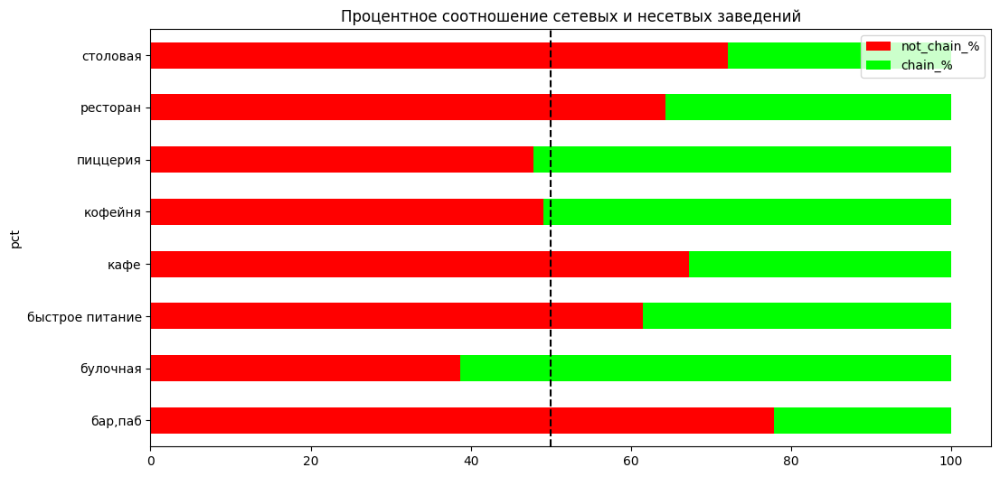

In [ ]:
print('Процентное соотношение сетевых и несетвых заведений')
display(category_chain_count[['not_chain_%','chain_%']].sort_index(ascending=False))
category_chain_count[['not_chain_%','chain_%']].plot(kind = 'barh', stacked=True,figsize=(12,6),color=['red','lime'],ylabel='pct')
plt.axvline(x=50,linestyle='--', color='black')
plt.title('Процентное соотношение сетевых и несетвых заведений')
plt.xlabel='pct'

**Вывод:**

Из таблиц и графиков сверху можно сделать вывод, что во всех случаях кроме пиццерий, кофеен и булочных количество несетевых заведений больше.

### Рассмотрим топ 15 самый популярных заведений:

In [ ]:
popular=data.query('chain==1').pivot_table(index='name',values='address',aggfunc='count').sort_values(by='address',ascending=False)
popular.columns=['count']
popular=popular.head(15)
popular['number']=range(1,popular.shape[0]+1)
popular=popular.reset_index().set_index('number')
print('Выведем таблицу с самыми популярными сетями в Москве:')
popular

Выведем таблицу с самыми популярными сетями в Москве:


,name,count
number,,
1,шоколадница,120
2,яндекс.лавка,116
3,домино'с пицца,76
4,додо пицца,74
5,one price coffee,71
6,cofix,65
7,prime,50
8,хинкальная,44
9,кофепорт,42


Данные сети существют в реальном мире. Я знаю сети с номерами: 1-7, 10, 11, 13 и 15.

Выведем датасет но только с 15-ю популярными сетевыми заведениями:

In [ ]:
popular_data=data[data['name'].isin(popular['name'])]
popular_data.head(3)

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats,street,street111,is_24/7
13,буханка,булочная,"Москва, Базовская улица, 15, корп. 1",Северный административный округ,"ежедневно, 08:00–22:00",55.877007,37.504980,4.8,NaN,NaN,NaN,NaN,1,180,улица Базовская,Базовская,False
23,буханка,булочная,"Москва, Лобненская улица, 13к2",Северный административный округ,"ежедневно, 08:00–22:00",55.888421,37.527106,4.7,NaN,NaN,NaN,NaN,1,<NA>,улица Лобненская,Лобненская,False
32,додо пицца,пиццерия,"Москва, Коровинское шоссе, 23, корп. 1",Северный административный округ,"ежедневно, 09:00–23:00",55.877388,37.523334,4.3,NaN,Средний счёт:328 ₽,328.0,NaN,1,46,шоссе Коровинское,Коровинское,False


In [ ]:
name_category_count_popular=popular_data.pivot_table(index='name',columns='category',values='seats',aggfunc='count')
name_category_count_popular['sum_x_old']=name_category_count_popular.sum(axis=1)
name_category_count_popular=name_category_count_popular.sort_values(by='sum_x_old')
name_category_count_popular=name_category_count_popular.drop(columns='sum_x_old')

print('Построим таблицу количества заведений распределеннх по категориям:')
name_category_count_popular.sum(axis=1).reset_index()

Построим таблицу количества заведений распределеннх по категориям:


,name,0
0,буханка,9.0
1,cofefest,10.0
2,wild bean cafe,10.0
3,чайхана,19.0
4,му-му,20.0
5,кофепорт,23.0
6,теремок,27.0
7,хинкальная,32.0
8,prime,33.0
9,cofix,36.0


In [ ]:
sns.set(font_scale=1.4)

Отобразим диаграмму сетей по количеству мест и доли в различных категриях:


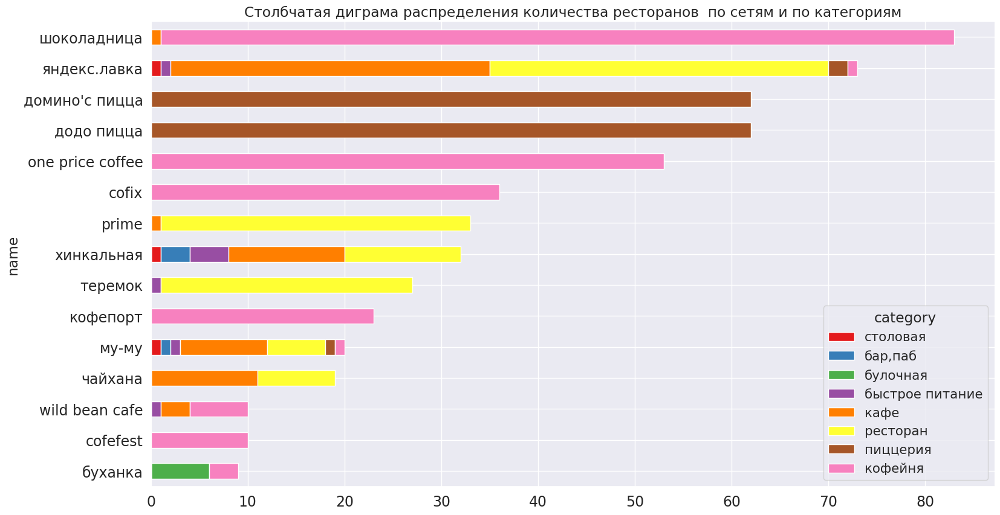

In [ ]:
name_category_count_popular.loc['sum_y',:]=name_category_count_popular.sum(axis=0)
name_category_count_popular=name_category_count_popular.sort_values(by='sum_y',axis=1,ascending=True)
name_category_count_popular=name_category_count_popular.drop(index='sum_y')
print('Отобразим диаграмму сетей по количеству мест и доли в различных категриях:')
sns.set_palette('Set1')
name_category_count_popular.plot(kind='barh',stacked=True,figsize=(18,10),fontsize=17,title='Столбчатая диграма распределения количества ресторанов  по сетям и по категориям')
sns.despine()

In [ ]:
fig=go.Figure(go.Pie(labels=name_category_count_popular.index,values=name_category_count_popular.sum(axis=1)))
fig.update_layout(title='Круговая диаграмма доли по сетям',
                 annotations=[dict(x=1.2,
                                   y=1.05,
                                   text='Популярные сети:',
                                  showarrow=False)])

In [ ]:
name_category_count_popular.loc['sum_y']=name_category_count_popular.sum()
name_category_count_popular=name_category_count_popular.fillna(0).sort_values(by='sum_y',axis=1,ascending=False)
name_category_count_popular=name_category_count_popular.astype('int')
name_category_count_popular.loc['pct',:]=round(name_category_count_popular.loc['sum_y',:]/name_category_count_popular.loc['sum_y',:].sum()*100,2)
name_category_count_popular=name_category_count_popular.sort_values(by='sum_y',axis=1,ascending=False)
print()
print('Данная таблица поможет отобразит свзяь количество сетей в категоряих')
name_category_count_popular


Данная таблица поможет отобразит свзяь количество сетей в категоряих


category,кофейня,пиццерия,ресторан,кафе,быстрое питание,булочная,"бар,паб",столовая
name,,,,,,,,
буханка,3.00,0.00,0.00,0.00,0.00,6.00,0.00,0.00
cofefest,10.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00
wild bean cafe,6.00,0.00,0.00,3.00,1.00,0.00,0.00,0.00
чайхана,0.00,0.00,8.00,11.00,0.00,0.00,0.00,0.00
му-му,1.00,1.00,6.00,9.00,1.00,0.00,1.00,1.00
кофепорт,23.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00
теремок,0.00,0.00,26.00,0.00,1.00,0.00,0.00,0.00
хинкальная,0.00,0.00,12.00,12.00,4.00,0.00,3.00,1.00
prime,0.00,0.00,32.00,1.00,0.00,0.00,0.00,0.00



Хитмап нагляднее отобразит эту таблцу:


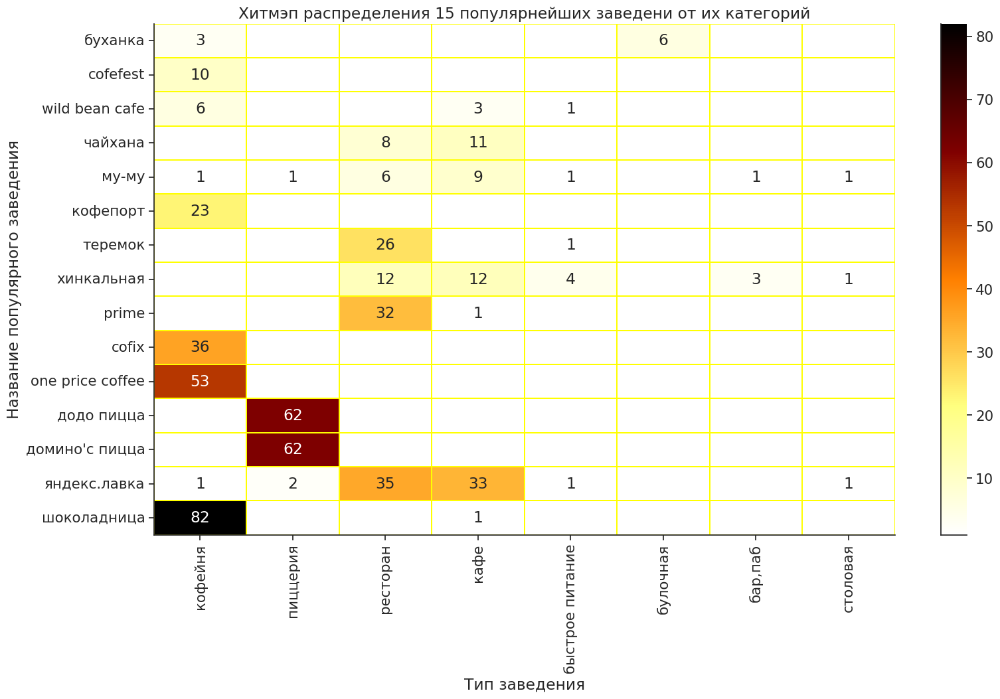

In [ ]:
for x in name_category_count_popular.columns:
    for y in name_category_count_popular.index:
        if name_category_count_popular.loc[y,x]==0:
            name_category_count_popular.loc[y,x]=None
print()
print('Хитмап нагляднее отобразит эту таблцу:')
sns.set_style('ticks')
plt.figure(figsize=(18,10))
ax=sns.heatmap(name_category_count_popular.drop(index=['sum_y','pct']),cmap='afmhot_r',annot=True,color='red',fmt='.6g',linewidths=0.005, linecolor='yellow')
ax.set(title = "Хитмэп распределения 15 популярнейших заведени от их категорий",
      xlabel='Тип заведения',
      ylabel='Название популярного заведения')

sns.despine()


___

**Далее выведем как распределются популярные сетевые  заведения по категорям безотносительно распределений по самим сетям**

In [ ]:
fig=go.Figure(go.Pie(labels=name_category_count_popular.columns,values=name_category_count_popular.loc['sum_y',:]))
fig.update_layout(title='Круговая диаграмма доли популярных сетевых заведений по категоряим',
                 annotations=[dict(x=1.14,
                                   y=1.05,
                                   text='Категории:',
                                  showarrow=False)])

In [ ]:
fig=px.bar(name_category_count_popular.T,y='sum_y',x=name_category_count_popular.columns)
fig.update_layout(
    yaxis_title="Количествоа заведений",
    xaxis_title="Тип заведения",
    title='Количество популярных сетевых заведений по категориям')
fig.show()

In [ ]:
pct=0
count=0
for x in range(0,len(name_category_count_popular.columns)):
    if x+1<=4:
        pct=pct+name_category_count_popular.loc['pct',name_category_count_popular.columns[x]]
        count=count+name_category_count_popular.loc['sum_y',name_category_count_popular.columns[x]]
print('Первые 4 (половина или ',round(4/len(name_category_count_popular.columns)*100)
      ,'%) категорий заведений, отсортированных от большего к меньшиму по количеству ',popular.shape[0],
      'самых популярных заведений занимают',round(pct,2),
      '% от всех таких заведений. Или другими словами',count,'из',name_category_count_popular.loc['sum_y',:].sum(),'заведений.')
print()
print('Выведем 4 самые популярные категории:')
for x in range(0,len(name_category_count_popular.columns)):
    if x+1<=4:
        print(x+1, '-' ,name_category_count_popular.columns[x])

Первые 4 (половина или  50 %) категорий заведений, отсортированных от большего к меньшиму по количеству  15 самых популярных заведений занимают 96.2 % от всех таких заведений. Или другими словами 531.0 из 552.0 заведений.

Выведем 4 самые популярные категории:
1 - кофейня
2 - пиццерия
3 - ресторан
4 - кафе


### **Далее рассмотрим информацию об округах Москвы:**

In [ ]:
print('В датасете представлены следующие ',data['district'].unique().shape[0],' районов (округов):')
print()
for x in range(0,len(data['district'].unique())):
    print('* -' ,data['district'].unique()[x])

В датасете представлены следующие  9  районов (округов):

* - Северный административный округ
* - Северо-Восточный административный округ
* - Северо-Западный административный округ
* - Западный административный округ
* - Центральный административный округ
* - Восточный административный округ
* - Юго-Восточный административный округ
* - Южный административный округ
* - Юго-Западный административный округ


Представлены все 9 районов внутри МКАДа.

In [ ]:
district_category=data.pivot_table(index='district',columns='category',values='name',aggfunc='count')
district_category=district_category.astype('int')
district_category['sum_x']=district_category.sum(axis=1)
district_category=district_category.sort_values(by='sum_x',ascending=False)
district_category=district_category.drop(columns='sum_x')
district_category.loc['sum_y',:]=district_category.sum(axis=0)
district_category=district_category.sort_values(by='sum_y',ascending=False,axis=1)
district_category=district_category.drop(index='sum_y')
district_category

category,кафе,ресторан,кофейня,"бар,паб",пиццерия,быстрое питание,столовая,булочная
district,,,,,,,,
Центральный административный округ,464.0,670.0,428.0,364.0,113.0,87.0,66.0,50.0
Северный административный округ,235.0,189.0,193.0,68.0,77.0,58.0,41.0,39.0
Южный административный округ,264.0,202.0,131.0,68.0,73.0,85.0,44.0,25.0
Северо-Восточный административный округ,269.0,182.0,159.0,63.0,68.0,82.0,40.0,28.0
Западный административный округ,239.0,218.0,150.0,50.0,71.0,62.0,24.0,37.0
Восточный административный округ,272.0,160.0,105.0,53.0,72.0,71.0,40.0,25.0
Юго-Восточный административный округ,282.0,145.0,89.0,38.0,55.0,67.0,25.0,13.0
Юго-Западный административный округ,238.0,168.0,96.0,38.0,64.0,61.0,17.0,27.0
Северо-Западный административный округ,115.0,109.0,62.0,23.0,40.0,30.0,18.0,12.0


In [ ]:
fig=go.Figure(go.Pie(labels=district_category.columns,values=district_category.sum()))
fig.update_layout(title='Распределение заведений по категориям',
                 annotations=[dict(x=1.12,
                                   y=1.05,
                                   text='Категории:',
                                  showarrow=False)])

In [ ]:
fig=go.Figure(go.Pie(labels=district_category.index,values=district_category.sum(axis=1)))
fig.update_layout(title='Распределение заведений по округам',
                 annotations=[dict(x=1.18,
                                   y=1.05,
                                   text='Округа:',
                                  showarrow=False)])

Хорошо будет продемонстрировать информацию о распределени количества заведений по округам и категорям **хитмэпом:**

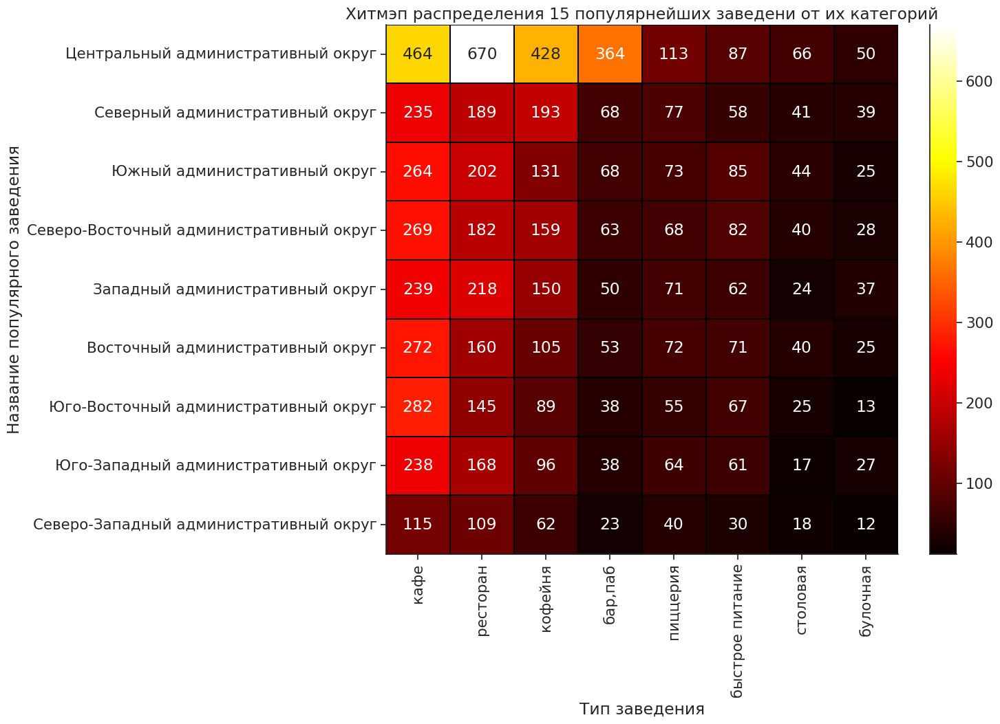

In [ ]:
plt.figure(figsize=(12, 10))

ax=sns.heatmap(district_category,cmap='hot',annot=True,fmt='.6g',linewidths=0.005, linecolor='black')
ax.set(title ="Хитмэп распределения 15 популярнейших заведени от их категорий",
      xlabel='Тип заведения',
      ylabel='Название популярного заведения')
sns.despine()

In [ ]:
sns.set(font_scale=1.4)

Отобразим диаграмму округов по количеству мест и их доли в различных категриях:


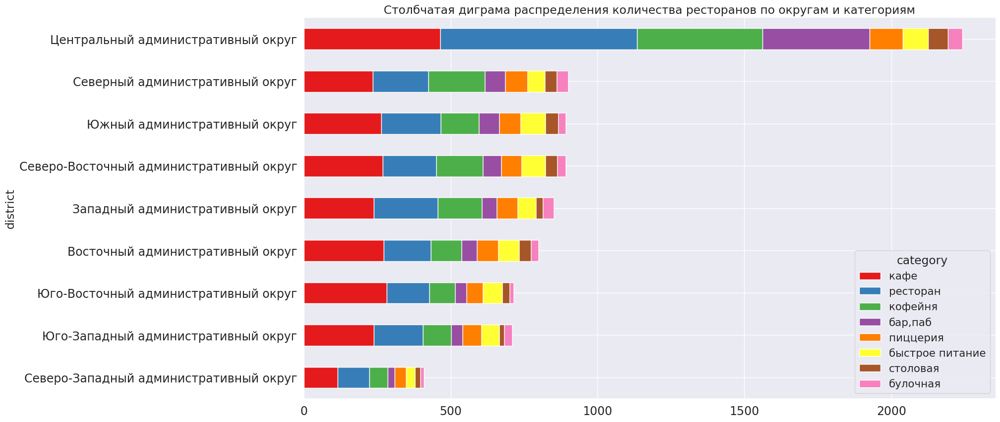

In [ ]:
district_category['sum_x']=district_category.sum(axis=1)
district_category=district_category.sort_values(by='sum_x',ascending=True)
district_category=district_category.drop(columns='sum_x')
print('Отобразим диаграмму округов по количеству мест и их доли в различных категриях:')
sns.set_palette('Set1')
district_category.plot(kind='barh',stacked=True,figsize=(18,10),fontsize=17,title='Столбчатая диграма распределения количества ресторанов по округам и категориям')
sns.despine()

Большая концентрация заведений в центре города. Так же в центре наиболольшую долю занимают рестораны, но в других частях Москвы это кафе. Все, АО кроме ЦАО примерно похожи, но  СЗАО немного отстает по количеству заведений.

### Визуализируем распределение средних рейтингов  по категориям:

In [ ]:
rating_category=data.pivot_table(index='rating',columns='category',values='name',
                 aggfunc='count').sort_index(ascending=False).fillna(0)
display(rating_category.head(3))
display(rating_category.tail(3))

category,"бар,паб",булочная,быстрое питание,кафе,кофейня,пиццерия,ресторан,столовая
rating,,,,,,,,
5.0,7.0,1.0,6.0,30.0,37.0,7.0,15.0,2.0
4.9,27.0,9.0,9.0,77.0,37.0,22.0,51.0,11.0
4.8,32.0,5.0,10.0,65.0,29.0,16.0,53.0,5.0


category,"бар,паб",булочная,быстрое питание,кафе,кофейня,пиццерия,ресторан,столовая
rating,,,,,,,,
1.2,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0
1.1,1.0,0.0,2.0,7.0,0.0,0.0,4.0,0.0
1.0,0.0,0.0,0.0,5.0,0.0,1.0,3.0,1.0


<Figure size 640x480 with 0 Axes>

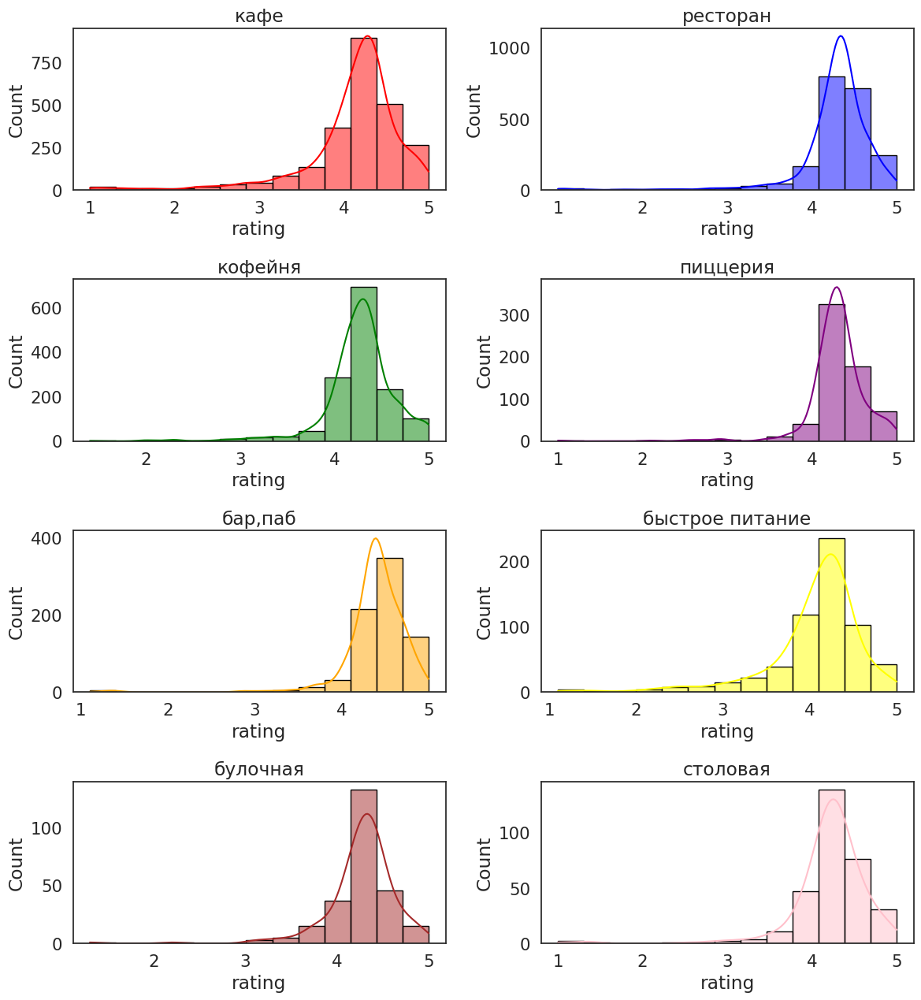

In [ ]:
sns.set_palette('coolwarm')
sns.set_style('white')
plt.suptitle("suptitle")
col=['red','blue','green','purple','orange','yellow','brown','pink']
plt.figure(figsize=(12, 13))
for b in data['category'].unique():
    sns.set_style('white')
    axn=[i for i in range(0, len(data['category'].unique())) if data['category'].unique()[i]==b][0]
    ax=sns.histplot(data = data[data['category']==b],x='rating', bins=13,ax=plt.subplot(4,2,axn+1),kde =True,color=col[axn],edgecolor='black')
    ax.set(title=b)
    plt.tight_layout()

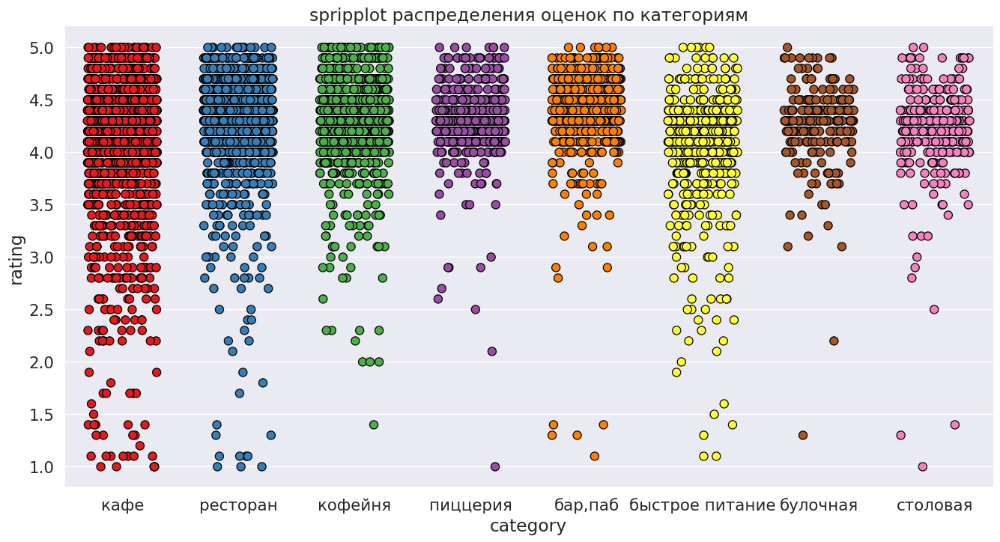

In [ ]:
plt.figure(figsize=(16, 8))
sns.set_style('darkgrid')
ax = sns.stripplot(x='category', y='rating', data=data, jitter=0.3 , palette='Set1',edgecolor='black',linewidth=0.9, s = 8)
ax.tick_params(axis='x')
ax.set(title='spripplot распределения оценок по категориям')
sns.despine()

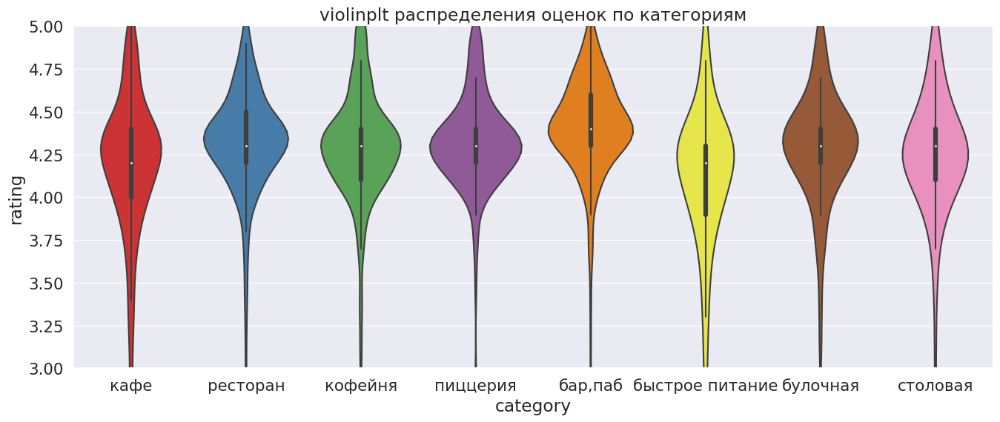

In [ ]:
plt.figure(figsize=(16, 6))
ax=sns.violinplot(x='category', y='rating', data=data, palette='Set1')
ax.set(title='violinplt распределения оценок по категориям')
plt.ylim(3, 5)
sns.despine()

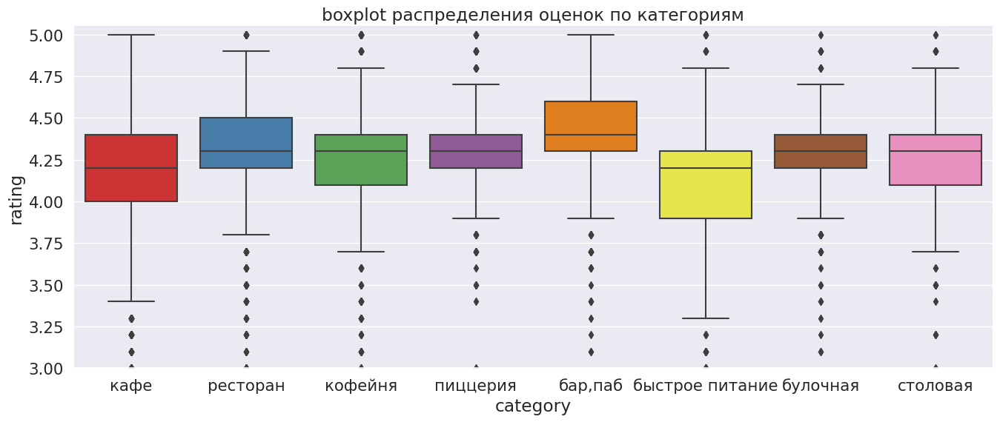

In [ ]:
plt.figure(figsize=(16, 6))
ax=sns.boxplot(x='category', y='rating', data=data, palette='Set1')
ax.set(title='boxplot распределения оценок по категориям')
plt.ylim(3, 5.05)
sns.despine()

**Вывод:**

Средние оценки для всех категорий находятся в пределах 4-4,5. Можно сказать что они не сильно отличаются.

In [ ]:
district_rating=data.pivot_table(index='district',values='rating',aggfunc=['mean','median']).reset_index()
district_rating=round(district_rating,3)
district_rating=district_rating.set_index(district_rating.index+1)
district_rating.columns=['district','mean_r','median_r']
print()
print('Выведем таблицу средних и медианных оценок по округам:')
district_rating


Выведем таблицу средних и медианных оценок по округам:


,district,mean_r,median_r
1,Восточный административный округ,4.174,4.3
2,Западный административный округ,4.182,4.3
3,Северный административный округ,4.240,4.3
4,Северо-Восточный административный округ,4.148,4.2
5,Северо-Западный административный округ,4.209,4.3
6,Центральный административный округ,4.378,4.4
7,Юго-Восточный административный округ,4.101,4.2
8,Юго-Западный административный округ,4.173,4.3
9,Южный административный округ,4.184,4.3


### Построим хороплет среднего рейтинга по округам Москвы:

In [ ]:
# читаем файл и сохраняем в переменной
with open('/content/drive/MyDrive/Практикум/admin_level_geomap.geojson', 'r') as f:
    geo_json = json.load(f)

print(json.dumps(geo_json, indent=2, ensure_ascii=False, sort_keys=True)[0:200])

{
  "features": [
    {
      "geometry": {
        "coordinates": [
          [
            [
              [
                37.8756653,
                55.825342400000004
              ],
         


In [ ]:
# загружаем JSON-файл с границами округов Москвы
state_geo = '/content/drive/MyDrive/Практикум/admin_level_geomap.geojson'
# moscow_lat - широта центра Москвы, moscow_lng - долгота центра Москвы
moscow_lat, moscow_lng = 55.751244, 37.618423

# создаём карту Москвы
m = Map(location=[moscow_lat, moscow_lng], zoom_start=9)

# создаём хороплет с помощью конструктора Choropleth и добавляем его на карту
Choropleth(
    geo_data=state_geo,
    data=district_rating,
    columns=['district', 'mean_r'],
    key_on='feature.name',
    fill_color='YlGn',
    fill_opacity=0.8,
    legend_name='Средний рейтинг заведений по районам',
).add_to(m)
print()
print('Отобразим хороплет средних рейтингов по округам:')
m


Отобразим хороплет средних рейтингов по округам:


Получилось визуализировать данные на карте, ведь так быстрее разобраться какая ситуация в каком округе в зависимости от показателя.   
</div>

### Отобразим все заведения общепита Москвы с их средним рейтингом на карте с кластеризацией:

In [ ]:
# moscow_lat - широта центра Москвы, moscow_lng - долгота центра Москвы
moscow_lat, moscow_lng = 55.751244, 37.618423

# создаём карту Москвы
m = Map(location=[moscow_lat, moscow_lng], zoom_start=10)
# создаём пустой кластер, добавляем его на карту
marker_cluster = MarkerCluster().add_to(m)

# пишем функцию, которая принимает строку датафрейма,
# создаёт маркер в текущей точке и добавляет его в кластер marker_cluster
def create_clusters(row):
    Marker(
        [row['lat'], row['lng']],
        popup=f"{row['name']} {row['rating']}",
    ).add_to(marker_cluster)

# применяем функцию create_clusters() к каждой строке датафрейма
data.apply(create_clusters, axis=1)
print()
print('Отобразим хороплет рейтингов заведений с кластеризацией для экономии ресурсов:')
# выводим карту
m


Отобразим хороплет рейтингов заведений с кластеризацией для экономии ресурсов:


____

Кластеры не сильно нагружают график из-за своей сгруппированности. Если убрать кластеры, то тетрадка будет работать тяжело из-за отображения буквально каждой точки на карте.
    
</div>

### **Проанализируем самые популярные улицы (15 лидеров ко количеству заведений на них).**

In [ ]:
street_count=data.pivot_table(index='street',values='name',aggfunc='count')
street_count.columns=['count']
street_count=street_count.sort_values(by='count',ascending=False)
street_count=street_count.reset_index()
street_count=street_count.set_index(street_count.index+1)
print()
print('Выведем таблицу количества заведений на каждой из 15 популярных улиц:')
street_count.head(15)


Выведем таблицу количества заведений на каждой из 15 популярных улиц:


,street,count
1,проспект Мира,184
2,улица Профсоюзная,122
3,проспект Вернадского,108
4,проспект Ленинский,107
5,проспект Ленинградский,95
6,шоссе Дмитровское,88
7,шоссе Каширское,77
8,шоссе Варшавское,76
9,шоссе Ленинградское,70
10,МКАД,65


In [ ]:
popular_street_data=data[data['street'].isin(street_count.head(15)['street'].values)]
print()
print('Выведем датасет, но только с популярными улицами:')
popular_street_data.head(3)


Выведем датасет, но только с популярными улицами:


,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats,street,street111,is_24/7
8,donna maria,ресторан,"Москва, Дмитровское шоссе, 107, корп. 4",Северный административный округ,"ежедневно, 10:00–22:00",55.880045,37.539006,4.8,средние,Средний счёт:от 500 ₽,500.0,NaN,0,79,шоссе Дмитровское,Дмитровское,False
12,заправка,кафе,"Москва, МКАД, 80-й километр, 1",Северный административный округ,вт-сб 09:00–18:00,55.899938,37.517958,4.3,средние,Средний счёт:330 ₽,330.0,NaN,0,<NA>,МКАД,МКАД,False
17,чайхана беш-бармак,ресторан,"Москва, Ленинградское шоссе, 71Б, стр. 2",Северный административный округ,"ежедневно, круглосуточно",55.876908,37.449876,4.4,средние,Средний счёт:350–500 ₽,425.0,NaN,0,96,шоссе Ленинградское,Ленинградское,True


In [ ]:
popular_street_category=popular_street_data.pivot_table(index='street',columns='category',values='name',aggfunc='count')
popular_street_category=popular_street_category.fillna(0).astype('int')
popular_street_category['sum_x']=popular_street_category.sum(axis=1)
popular_street_category=popular_street_category.sort_values(by='sum_x',axis=0,ascending=False)
popular_street_category=popular_street_category.drop(columns='sum_x')
#----------------------
popular_street_category.loc['sum_y',:]=popular_street_category.sum(axis=0)
popular_street_category=popular_street_category.sort_values(by='sum_y',axis=1,ascending=False)
popular_street_category=popular_street_category.drop(index='sum_y')
popular_street_category=popular_street_category.astype('int')
print()
print('Отобразим таблицу распределения количества заведений по популярными улицам и категориям:')
popular_street_category


Отобразим таблицу распределения количества заведений по популярными улицам и категориям:


category,кафе,ресторан,кофейня,быстрое питание,"бар,паб",пиццерия,столовая,булочная
street,,,,,,,,
проспект Мира,53,45,36,21,12,11,2,4
улица Профсоюзная,35,26,18,15,6,15,3,4
проспект Вернадского,25,33,16,12,7,12,2,1
проспект Ленинский,26,33,23,2,10,5,5,3
проспект Ленинградский,12,25,25,2,15,9,3,4
шоссе Дмитровское,23,24,11,10,6,8,4,2
шоссе Каширское,20,19,16,10,2,5,5,0
шоссе Варшавское,18,20,14,7,6,4,7,0
шоссе Ленинградское,13,26,13,5,5,3,3,2


In [ ]:
fig=go.Figure(go.Pie(labels=popular_street_category.columns,values=popular_street_category.sum()))
fig.update_layout(title='Распределение заведений по категориям',
                 annotations=[dict(x=1.12,
                                   y=1.05,
                                   text='Категории:',
                                  showarrow=False)])

In [ ]:
fig=go.Figure(go.Pie(labels=popular_street_category.index,values=popular_street_category.sum(axis=1)))
fig.update_layout(title='Распределение заведений по категориям',
                 annotations=[dict(x=1.12,
                                   y=1.05,
                                   text='Категории:',
                                  showarrow=False)])

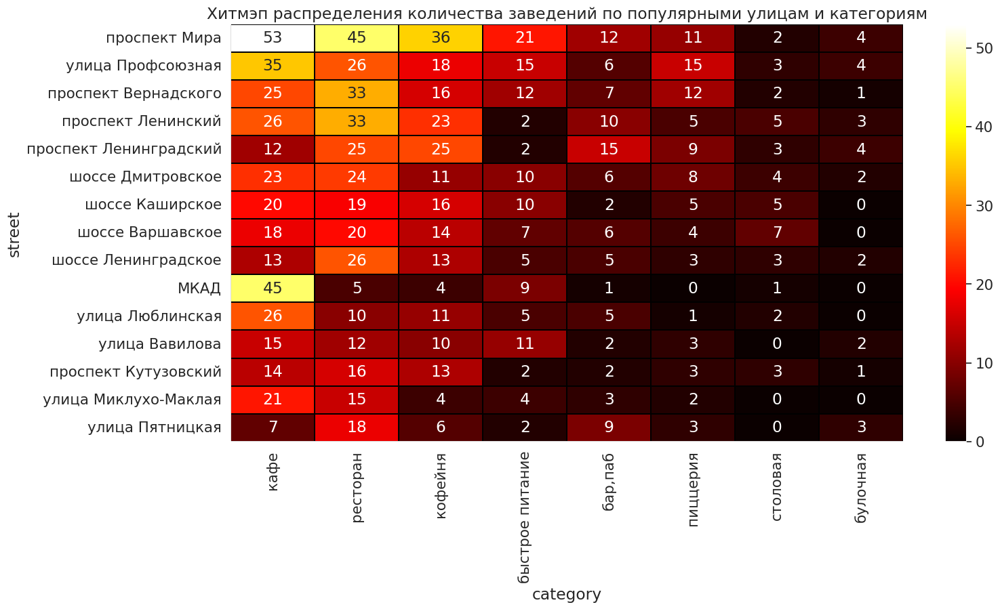

In [ ]:
plt.figure(figsize=(16,8))
ax=sns.heatmap(popular_street_category,cmap='hot',annot=True,linewidths=0.005, linecolor='black')
ax.set(title='Хитмэп распределения количества заведений по популярными улицам и категориям')
sns.despine()

In [ ]:
sns.set(font_scale=1.4)

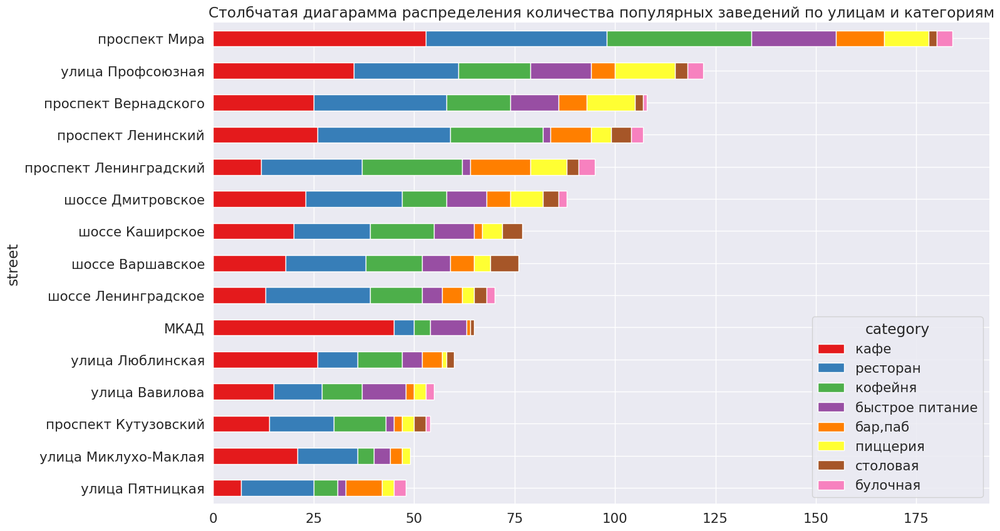

In [ ]:

popular_street_category['sum_x']=popular_street_category.sum(axis=1)
popular_street_category=popular_street_category.sort_values(by='sum_x',axis=0,ascending=True)
popular_street_category=popular_street_category.drop(columns='sum_x')
sns.set_palette('Set1')
popular_street_category.plot(kind='barh',stacked=True,figsize=(16,10),title='Cтолбчатая диагарамма распределения количества популярных заведений по улицам и категориям')
sns.despine()

___

Возможно это улицы такие большие и поэтому в них большое количестов объектов питания
    
</div>

У нас есть топ улиц, исходя из задания. Но, если мы подумаем – то можем ли мы утверждать, что этот топ улиц действительно полезный для реальной задачи ?
    
Было бы интересно посмотреть на плотность заведений на 1 км. и далее ранжировать по этому расчету улицы.
    
</div>

### **Пронализируем улицы с 1 заведением общепита.**

Введем переменную one_cafe_street_data - датасет улиц с одним заведением

In [ ]:
one_cafe_street_data=data[data['street'].isin(street_count.query('count==1')['street'])]
category_one_cafe_street=one_cafe_street_data.pivot_table(index='category',values='name',aggfunc='count')
category_one_cafe_street.columns=['count']
category_one_cafe_street=category_one_cafe_street.sort_values(by='count',ascending=False)
print()
print('Отобразим таблицу количества заведений по категориям с такими заведениями:')
category_one_cafe_street


Отобразим таблицу количества заведений по категориям с такими заведениями:


,count
category,
кафе,167
ресторан,94
кофейня,90
"бар,паб",41
столовая,37
быстрое питание,25
пиццерия,15
булочная,9


In [ ]:
print()
print('Заведения единственные на своей улице:')
fig=go.Figure(go.Pie(labels=category_one_cafe_street.index,values=category_one_cafe_street['count']))
fig.update_layout(title='Распределение заведений по категориям',
                 annotations=[dict(x=1.15,
                                   y=1.05,
                                   text='Категории:',
                                  showarrow=False)])


Заведения единственные на своей улице:


In [ ]:
print()
print('Заведения единственные на своей улице:')
one_cafe_street_chain=one_cafe_street_data['chain'].value_counts().reset_index()
one_cafe_street_chain.columns=['chain_status','quantity']
one_cafe_street_chain.loc[0,'chain_status']='not_chain_cafe'
one_cafe_street_chain.loc[1,'chain_status']='chain_cafe'
one_cafe_street_chain
fig=go.Figure(go.Pie(labels=one_cafe_street_chain['chain_status'],values=one_cafe_street_chain['quantity']))
fig.update_layout(title='Распределение заведений на сетевые и несетевые',
                 annotations=[dict(x=1.21,
                                   y=1.05,
                                   text='Сетевое заведение?',
                                  showarrow=False)])


Заведения единственные на своей улице:


In [ ]:
print()
print('Заведения единственные на своей улице:')
one_cafe_street_24_on_7=one_cafe_street_data['is_24/7'].value_counts().reset_index()
one_cafe_street_24_on_7.columns=['is_24/7','quantity']
one_cafe_street_24_on_7
fig=go.Figure(go.Pie(labels=one_cafe_street_24_on_7['is_24/7'],values=one_cafe_street_24_on_7['quantity']))
fig.update_layout(title='Распределение заведений по графику работы',
                 annotations=[dict(x=1.08,
                                   y=1.05,
                                   text='24/7?',
                                  showarrow=False)])


Заведения единственные на своей улице:


**Вывод:**

Можно сделать вывод что на улицах Москвы, где представлен всего 1 ресторан, доля сетевых заведений почти на 12% меньнше - сетевые менеджеры явно не рискуют открываться в новых местах а следуют общему тренду.

### **Проанализируем как распределяется и как зависит средний чек по округам Москвы:**

In [ ]:
district_mean_bill=data.pivot_table(index='district',values='middle_avg_bill',
                 aggfunc='median').sort_values(by='middle_avg_bill',ascending=False).reset_index()
district_mean_bill=district_mean_bill.set_index(district_mean_bill.index+1)
print()
print('Выведем таблицу округов и средних чеков в них:')
district_mean_bill


Выведем таблицу округов и средних чеков в них:


,district,middle_avg_bill
1,Западный административный округ,1000.0
2,Центральный административный округ,1000.0
3,Северо-Западный административный округ,700.0
4,Северный административный округ,650.0
5,Юго-Западный административный округ,600.0
6,Восточный административный округ,575.0
7,Северо-Восточный административный округ,500.0
8,Южный административный округ,500.0
9,Юго-Восточный административный округ,450.0


In [ ]:
pr_m = Map(location=[moscow_lat, moscow_lng], zoom_start=10)
Choropleth(
    geo_data=state_geo,
    data=district_mean_bill,
    columns=['district', 'middle_avg_bill'],
    key_on='feature.name',
    fill_color='YlGn',
    fill_opacity=0.8,
    legend_name='Цена медианного чека заведений по районам',
).add_to(pr_m)
print()
print('Хороплет средней цены заказа по округам города Москвы:')
pr_m


Хороплет средней цены заказа по округам города Москвы:


**Вывод:**

Судя по хоплету выше средний чек уменьшается при удалении от центра везде кроме ЗАО.

**Проверим этот вывод с помощью корреляции:**

Для начала определим параметры Земли - это будет нужно для определения расстояния от центра города:

In [ ]:
lat_meters_degree=40007863/360
lng_meters_degree_M=40075017/360*math.cos(math.radians(moscow_lat))
print('Cколько километров в градусе координаты (широты и долготы)?')
print()
print('В в одном градусе широты:',lat_meters_degree,'метров для любой широты и долготы Земли;')
print()
print('В в одном градусе долготы:',40075017/360,'метров для ЭКВАТОРА Земли;')
print()
print('В в одном градусе долготы:',lng_meters_degree_M,'метров для широты Москвы.')

Cколько километров в градусе координаты (широты и долготы)?

В в одном градусе широты: 111132.95277777778 метров для любой широты и долготы Земли;

В в одном градусе долготы: 111319.49166666667 метров для ЭКВАТОРА Земли;

В в одном градусе долготы: 62649.160611685926 метров для широты Москвы.


Сделаем таблицу с дельтой (разницой) долготы и широты от центра Москвы безотносительно знака.

Далее умножим на наши 1 градус долготы и 1 градус широта Москвы и получим расстояние до центра города от каждого заведения!

In [ ]:
distance=pd.DataFrame({'name':data['name'],'delta_lat_m':abs(data['lat']-moscow_lat)*lat_meters_degree,
                       'delta_lng_m':abs(data['lng']-moscow_lng)*lng_meters_degree_M})
distance['squaring_sum']=(distance['delta_lat_m']**2+distance['delta_lng_m']**2)
for x in distance.index:
    distance.loc[x,'distance_m']=math.sqrt(distance.loc[x,'squaring_sum'])

distance.head()

,name,delta_lat_m,delta_lng_m,squaring_sum,distance_m
0,wowфли,14141.668241,8743.504802,2.764357e+08,16626.354287
1,четыре комнаты,13842.387199,8391.479169,2.620286e+08,16187.297675
2,хазри,15325.456454,5796.425638,2.684682e+08,16384.998190
3,dormouse coffee shop,14487.736256,8117.013196,2.757804e+08,16606.637379
4,иль марко,14438.615491,10591.842988,3.206608e+08,17907.002965


Добавим исходный датасет этот параметр:

In [ ]:
data['distance_m']=distance['distance_m']
data.head(2)

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats,street,street111,is_24/7,distance_m
0,wowфли,кафе,"Москва, улица Дыбенко, 7/1",Северный административный округ,"ежедневно, 10:00–22:00",55.878494,37.478860,5.0,NaN,NaN,NaN,NaN,0,<NA>,улица Дыбенко,Дыбенко,False,16626.354287
1,четыре комнаты,ресторан,"Москва, улица Дыбенко, 36, корп. 1",Северный административный округ,"ежедневно, 10:00–22:00",55.875801,37.484479,4.5,выше среднего,Средний счёт:1500–1600 ₽,1550.0,NaN,0,4,улица Дыбенко,Дыбенко,False,16187.297675


Для этой части анализа уберем пропуски в среднем значении чека нашего датасета:

In [ ]:
spisok=['middle_avg_bill','distance_m']
data[['middle_avg_bill','distance_m','avg_bill','middle_coffee_cup']].isna().sum()

middle_avg_bill      5257
distance_m              0
avg_bill             4590
middle_coffee_cup    7871
dtype: int64

In [ ]:
data_bil_not_null=data[data['middle_avg_bill'].isna()==False]
print('Количество строк в таблице без пропущенных средних чеков:',data_bil_not_null.shape[0])

Количество строк в таблице без пропущенных средних чеков: 3149



Boxplot'ы среднего чека и расстоянии от центра


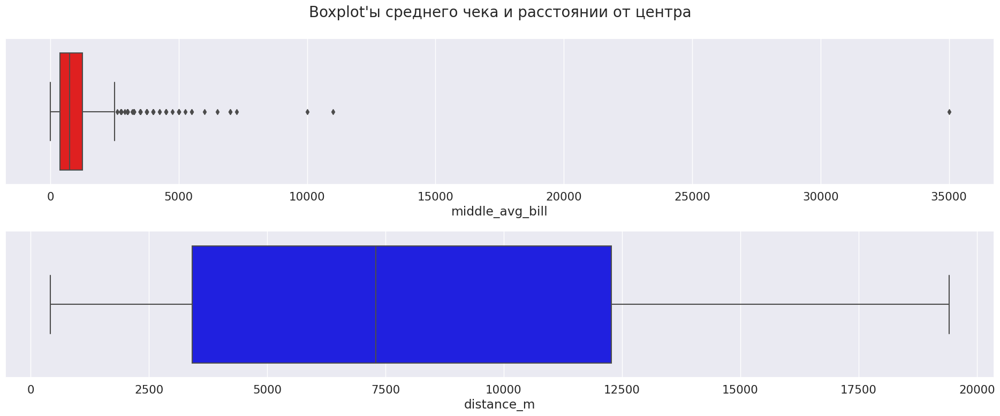

In [ ]:
print()
print("Boxplot'ы среднего чека и расстоянии от центра")
fig, axes = plt.subplots(2, 1, figsize=(19, 8))
fig.suptitle("Boxplot'ы среднего чека и расстоянии от центра", fontsize=20);
for b in spisok:
    axn=[i for i in range(0, len(spisok)) if spisok[i]==b][0]
    sns.boxplot(data = data_bil_not_null,x=b,ax=axes[axn],color=['red','blue'][axn])
    plt.tight_layout()



Построим график регрессии или зависимости одного параметра от другого:


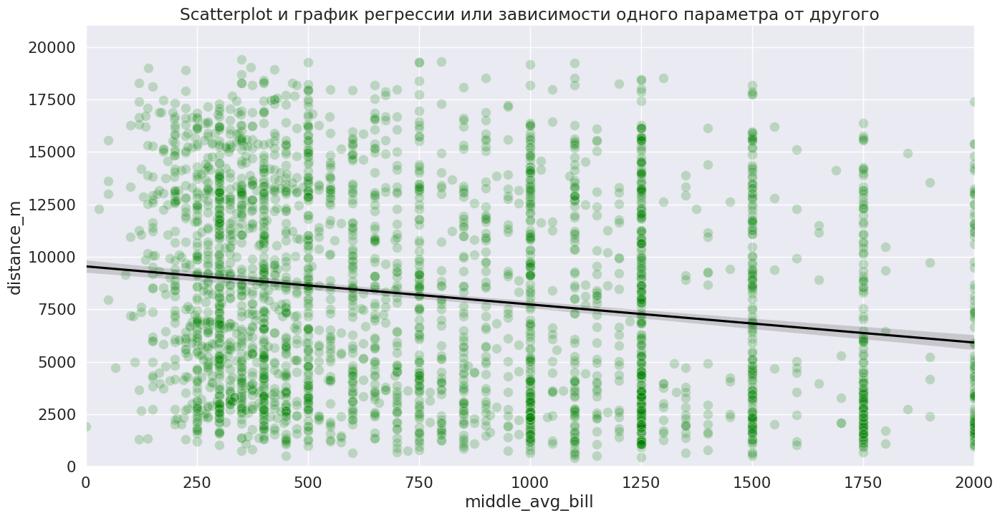

In [ ]:
print()
print("Построим график регрессии или зависимости одного параметра от другого:")
data_bil_not_null=data_bil_not_null[data_bil_not_null['middle_avg_bill']<=np.percentile(data_bil_not_null['middle_avg_bill'],96)]
plt.figure(figsize=(16,8))
sns.scatterplot(data=data_bil_not_null,x='middle_avg_bill',y='distance_m',color='green',alpha=0.2,s=100)
ax=sns.regplot(data=data_bil_not_null,x='middle_avg_bill',y='distance_m',color='black',scatter =False)
ax.set(title='Scatterplot и график регрессии или зависимости одного параметра от другого')
plt.xlim(0,2000)
plt.ylim(0,21000)
sns.despine()

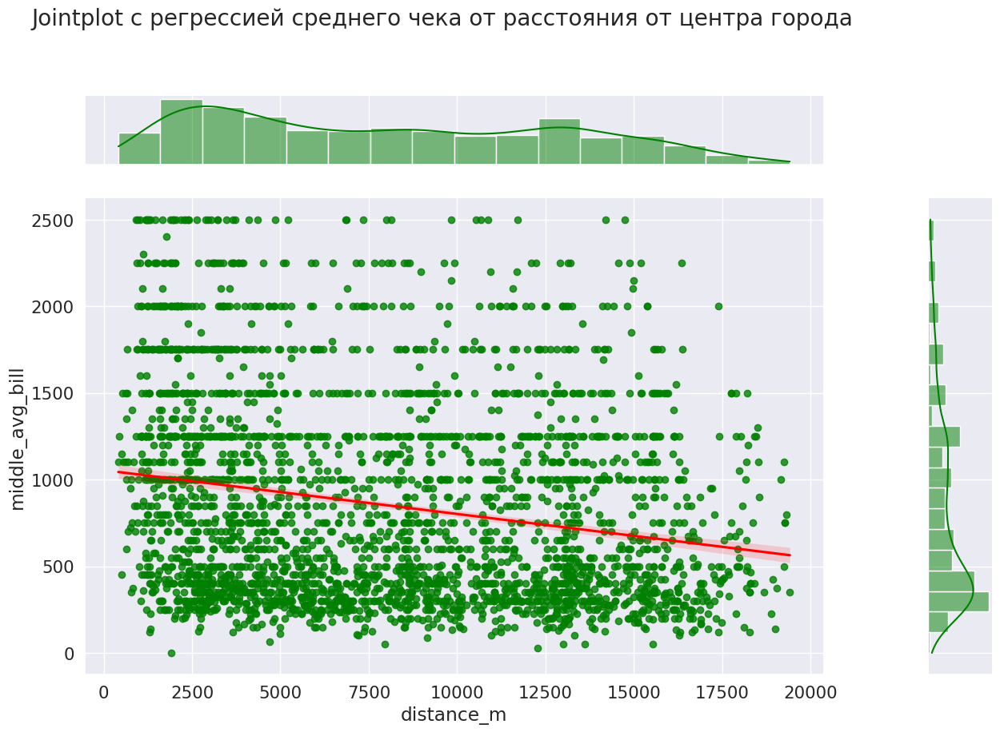

In [ ]:
ax=sns.jointplot(y="middle_avg_bill",
              x="distance_m",
              data=data_bil_not_null,kind='reg',color='green',joint_kws={'line_kws':{'color':'red'}})
ax.fig.suptitle("Jointplot с регрессией среднего чека от расстояния от центра города")
ax.fig.tight_layout()
ax.fig.set_size_inches((15, 10))
sns.despine()

In [ ]:
print('__________________________________________________________________________')
print()
print('Корреляция среднего чека и расстояния от центра города равна',round(data_bil_not_null['middle_avg_bill']
                                                                           .corr(data_bil_not_null['distance_m']),3))
print('__________________________________________________________________________')

__________________________________________________________________________

Корреляция среднего чека и расстояния от центра города равна -0.214
__________________________________________________________________________


**Корреляция слабая - это может говорить что либо связи вовсе нет и число случайным образом так распределились, либо то что связь есть но она слаба и не является ключевой для зависимости двух показателей.**

In [ ]:
y = data_bil_not_null['middle_avg_bill']
x = data_bil_not_null['distance_m']
x = sm.add_constant(x)
model = sm.OLS(y, x).fit()
print(model.summary())

                            OLS Regression Results                            
Dep. Variable:        middle_avg_bill   R-squared:                       0.046
Model:                            OLS   Adj. R-squared:                  0.046
Method:                 Least Squares   F-statistic:                     146.1
Date:                Tue, 04 Jul 2023   Prob (F-statistic):           6.84e-33
Time:                        20:17:09   Log-Likelihood:                -23610.
No. Observations:                3045   AIC:                         4.722e+04
Df Residuals:                    3043   BIC:                         4.724e+04
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const       1054.4767     19.597     53.809      0.0

По результатам теста МНК можно сказать, что около 4.6 % вариации среднего чека можно объяснить расстоянием. Модель явлется статзначимой. Формулу такой слабой модели приводить не стоит.

In [ ]:
print()
print("Хороплет с кластеризацией и расстоянием от центра в лейбле точки на карте у заведения")
pr_d_m = Map(location=[moscow_lat, moscow_lng], zoom_start=10)
# создаём пустой кластер, добавляем его на карту
marker_cluster = MarkerCluster().add_to(pr_d_m)

# пишем функцию, которая принимает строку датафрейма,
# создаёт маркер в текущей точке и добавляет его в кластер marker_cluster
def create_clusters(row):
    Marker(
        [row['lat'], row['lng']],
        popup=f"{row['name']} {row['middle_avg_bill']}  {round(row['distance_m'])}",
    ).add_to(marker_cluster)

# применяем функцию create_clusters() к каждой строке датафрейма
data[data['middle_avg_bill'].isna()==False].apply(create_clusters, axis=1)

pr_d_m# выводим карту


Хороплет с кластеризацией и расстоянием от центра в лейбле точки на карте у заведения


**Вывод: Корреляция у этих показатейлей слабая (-0.214). Регрессия объясняет всего 4,6% вариаций одного показателя от другого. Все это значит малое влияение расстояния от центра на цену среднего чека в Москве.**

In [ ]:
data_coffe_not_null=data[data['middle_coffee_cup'].isna()==False]
print('Количество строк в таблице без пропущенных средних чеков:',data_coffe_not_null.shape[0])

Количество строк в таблице без пропущенных средних чеков: 535


[Text(0.5, 1.0, 'Boxplot распределения цена средний чашки капучино')]

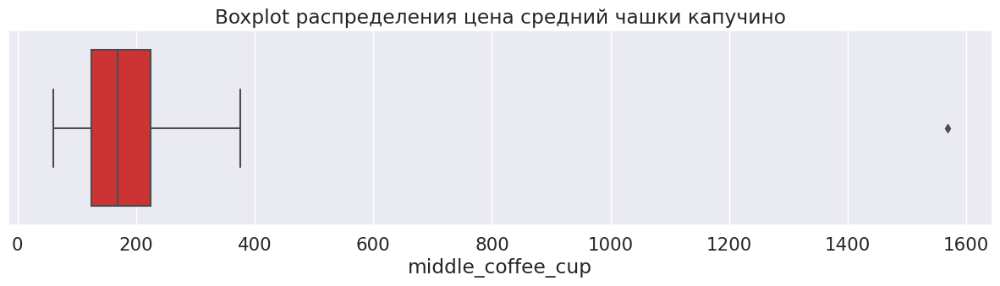

In [ ]:
plt.figure(figsize=(15,3))
ax=sns.boxplot(data = data_coffe_not_null,x='middle_coffee_cup')
ax.set(title='Boxplot распределения цена средний чашки капучино')

<Axes: xlabel='middle_coffee_cup', ylabel='distance_m'>

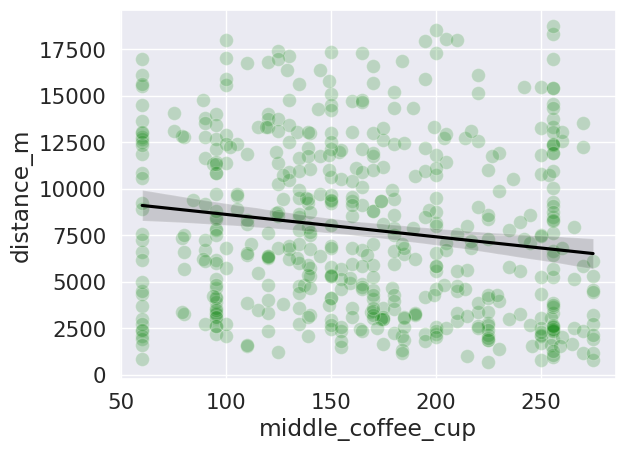

In [ ]:
data_coffe_not_null=data_coffe_not_null[data_coffe_not_null['middle_coffee_cup']<=np.percentile(data_coffe_not_null['middle_coffee_cup'],96)]
sns.scatterplot(data=data_coffe_not_null,x='middle_coffee_cup',y='distance_m',color='green',alpha=0.2,s=100)
sns.regplot(data=data_coffe_not_null,x='middle_coffee_cup',y='distance_m',color='black',scatter =False)

In [ ]:
print('Корреляция среднего чека и расстояния от центра города равна',round(data_coffe_not_null['middle_coffee_cup']
                                                                           .corr(data_coffe_not_null['distance_m']),3))

Корреляция среднего чека и расстояния от центра города равна -0.161


**ВЫВОД:**

**В датасете представлено 8 категорий заведений:**

1) кафе;

2) ресторан;

3) кофейня;

4) пиццерия;

5) бар,паб;

6) быстрое питание;

7) булочная;

8) столовая.

В среднем  посадочных мест больше всего в барах и пабах. Возможно это из-за барных стульев, ведь они занимают не очень много места, но вмещают много людей за барной стойкой. На втором месте рестораны, что не странно. На 3 и 4 местах кофейни и столовые - здесь страно, что в кофейнях больше мест чем в столовых. При сравнении медиан первое место у ресторанов а второе у баров, дальше без изменений.

**Несетвых заведений около 60%, а сетевых около 40%. Во всех случаях кроме пиццерий, кофеен и булочных количество несетевых заведений больше.**

-

**Убывание количество заведений в списке сетей равномерное нежели убывание в том же списке количества заведений по категориям:**

**Первые 4 (половина или  50 %) категорий заведений, отсортированных от большего к меньшиму по количеству 15 самых популярных заведений занимают 96.2 % от всех таких заведений. Или другими словами 531 из 552 заведений.**

**Выведем 4 самые популярные категории:**

1) кофейня;

2) пиццерия;

3) ресторан;

4) кафе.

**В датасете представлены все 9 районов (округов) внутри МКАДа:**

 - Северный административный округ;
 - Северо-Восточный административный округ;
 - Северо-Западный административный округ;
 - Западный административный округ;
 - Центральный административный округ;
 - Восточный административный округ;
 - Юго-Восточный административный округ
 - Южный административный округ;
 - Юго-Западный административный округ.

Хорошо отображает **распределение количества заведений по округам и категориям** хитмэп и барплот с накоплением - видно как **сильно выделяется ЦАО**.

**Средние оценки для всех категорий находятся в пределах 4-4,5. Можно сказать что они не сильно отличаются, но лидируют бары и пабы.**

**Рейтинг по округу отличается уже сильнее - в центре оценки выше на 20 сотых(4.38)**, тогда как в других окргуах около 4.10 до 4.20. 4.24 у САО.

**Распределение** количества **заведений по популярными улицам** и категориям тоже представлены в виде столбчатой диаграммы с накоплением и хитмэпом. **Больше все таких заведений на улицах: Проспект мира, Профсоюзная, проспект Вернадского и Ленинский проспект. По категориям это кафе, ресторан и кофейня.**

Можно сделать вывод что **на улицах Москвы, где представлен всего 1 ресторан, доля сетевых заведений почти на 12% меньнше** - сетевые **менеджеры явно не рискуют** открываться в новых местах а следуют общему тренду.

**Судя по хоплету выше средний чек уменьшается при удалении от центра везде кроме ЗАО.**

**НО**

**Корреляция между расстоянием и средним чеком слабая (-0.214)** - это может говорить что либо связи вовсе нет и число случайным образом так распределились, либо то что связь есть но она слаба и не является ключевой для зависимости двух показателей.

**Регрессия**, построенная методом наименьших квадратов, **объясняет всего 4,6% вариаций среднего чека показателя от расстояния.**

**Все это значит малое влияение расстояния от центра на цену среднего чека в Москве.**


## Анализ открытия кофейни:

### Проанализируем как распределяется кофейни по районам:

Оставим в датасете только кофейни и запишим в переменную coffee_data:

In [ ]:
coffee_data=data.query('category=="кофейня"')
coffee_data.head(3)

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats,street,street111,is_24/7,distance_m
3,dormouse coffee shop,кофейня,"Москва, улица Маршала Федоренко, 12",Северный административный округ,"ежедневно, 09:00–22:00",55.881608,37.488860,5.0,NaN,Цена чашки капучино:155–185 ₽,NaN,170.0,0,<NA>,улица Маршала Федоренко,Маршала Федоренко,False,16606.637379
25,в парке вкуснее,кофейня,"Москва, парк Левобережный",Северный административный округ,"ежедневно, 10:00–21:00",55.878453,37.460028,4.3,NaN,NaN,NaN,NaN,1,<NA>,парк Левобережный,Левобережный,False,17272.234552
45,9 bar coffee,кофейня,"Москва, Коровинское шоссе, 41, стр. 1",Северный административный округ,пн-пт 08:00–18:00,55.885837,37.513422,4.0,NaN,NaN,NaN,NaN,1,46,шоссе Коровинское,Коровинское,False,16340.328973


In [ ]:
print('В датасете всего',coffee_data.shape[0],'кофеен.')

В датасете всего 1413 кофеен.


Проанализируем как распределяется кофейни по районам:

In [ ]:
district_count_coffee=coffee_data.pivot_table(index='district',values='name',aggfunc='count')
district_count_coffee.columns=['count']
district_count_coffee=district_count_coffee.sort_values(by='count',ascending=False).reset_index()
district_count_coffee=district_count_coffee.set_index(district_count_coffee.index+1)
district_count_coffee['pct_%']=round(district_count_coffee['count'].astype('float')/district_count_coffee['count'].sum(axis=0)*100).astype('int')
print()
print('Таблица распределения кофеен по районам:')
district_count_coffee


Таблица распределения кофеен по районам:


,district,count,pct_%
1,Центральный административный округ,428,30
2,Северный административный округ,193,14
3,Северо-Восточный административный округ,159,11
4,Западный административный округ,150,11
5,Южный административный округ,131,9
6,Восточный административный округ,105,7
7,Юго-Западный административный округ,96,7
8,Юго-Восточный административный округ,89,6
9,Северо-Западный административный округ,62,4


In [ ]:
fig=go.Figure(go.Pie(labels=district_count_coffee['district'],values=district_count_coffee['count']))
fig.update_layout(title='Распределение кофеен по округам',
                 annotations=[dict(x=1.12,
                                   y=1.05,
                                   text='Округ:',
                                  showarrow=False)])

In [ ]:
fig=px.bar(district_count_coffee.sort_values(by='count'),y='district',x='count')
fig.update_layout(title='Распределение кофеен по округам')

___

In [ ]:
print()
print('Хороплет количества кофеен по округам города Москвы:')
c_d_m = Map(location=[moscow_lat, moscow_lng], zoom_start=10)
Choropleth(
    geo_data=state_geo,
    data=district_count_coffee,
    columns=['district', 'count'],
    key_on='feature.name',
    fill_color='YlGn',
    fill_opacity=0.8,
    legend_name='Количество заведений по районам',
).add_to(c_d_m)
c_d_m


Хороплет количества кофеен по округам города Москвы:


**Далее соберем таблицу с использованем h3 для построени hexbin - шестиуголников которые своим цветом покажут нам плотность распределения кофеен в Москве:**

In [ ]:
resolution = 7
coffee_data_map = coffee_data[['name', 'lat', 'lng']]
coffee_data_map.columns=['name', 'lat', 'long']
lat, lng, res= 55.751244, 37.618423, 9
h3.geo_to_h3(lat, lng, res)
hex_ids = coffee_data_map.apply(lambda row: h3.geo_to_h3(row.lat, row.long, resolution), axis = 1)
coffee_data_map = coffee_data_map.assign(hex_id=hex_ids.values)
coffee_data_map.head(4)

,name,lat,long,hex_id
3,dormouse coffee shop,55.881608,37.488860,8711aa72effffff
25,в парке вкуснее,55.878453,37.460028,8711aa723ffffff
45,9 bar coffee,55.885837,37.513422,8711aa72affffff
46,cofefest,55.879934,37.492522,8711aa72affffff


In [ ]:
coffee_data_map_hexid = coffee_data_map.groupby("hex_id", as_index=False).agg({"name": "count"})
coffee_data_map_hexid.columns = ["hex_id", "value"]
coffee_data_map_hexid
coffee_data_map_hexid["percentile"] = [st.percentileofscore(coffee_data_map_hexid["value"].values, i) for i in coffee_data_map_hexid["value"].values]
coffee_data_map_hexid.sort_values(by = "value", ascending = False, inplace = True)
coffee_data_map_hexid.head(4)

,hex_id,value,percentile
125,8711aa78cffffff,51,100.000000
150,8711aa7adffffff,39,99.371069
147,8711aa7aaffffff,38,98.113208
145,8711aa7a8ffffff,38,98.113208


In [ ]:
def hexagons_dataframe_to_geojson(df_hex, file_output = None, column_name = "value"):
    """
    Produce the GeoJSON for a dataframe, constructing the geometry from the "hex_id" column
    and with a property matching the one in column_name
    """
    list_features = []

    for i,row in df_hex.iterrows():
        try:
            geometry_for_row = { "type" : "Polygon", "coordinates": [h3.h3_to_geo_boundary(h=row["hex_id"],geo_json=True)]}
            feature = Feature(geometry = geometry_for_row , id=row["hex_id"], properties = {column_name : row[column_name]})
            list_features.append(feature)
        except:
            print("An exception occurred for hex " + row["hex_id"])

    feat_collection = FeatureCollection(list_features)
    geojson_result = json.dumps(feat_collection)
    return geojson_result

def get_color(custom_cm, val, vmin, vmax):
    return matplotlib.colors.to_hex(custom_cm((val-vmin)/(vmax-vmin)))

def choropleth_map(df_aggreg, column_name = "value", border_color = 'black', fill_opacity = 0.5, color_map_name = "ghj", initial_map = None):
    """
    Creates choropleth maps given the aggregated data. initial_map can be an existing map to draw on top of.
    """
    #colormap
    min_value = df_aggreg[column_name].min()
    max_value = df_aggreg[column_name].max()
    mean_value = df_aggreg[column_name].mean()
    print(f"Colour column min value {min_value}, max value {max_value}, mean value {mean_value}")
    print(f"Hexagon cell count: {df_aggreg['hex_id'].nunique()}")

    # the name of the layer just needs to be unique, put something silly there for now:
    name_layer = "Choropleth " + str(df_aggreg)

    if initial_map is None:
        initial_map = folium.Map(location= [55.751244, 37.618423], zoom_start=10)

    #create geojson data from dataframe
    geojson_data = hexagons_dataframe_to_geojson(df_hex = df_aggreg, column_name = column_name)

    custom_cm = matplotlib.cm.get_cmap(color_map_name)

    folium.GeoJson(
        geojson_data,
        style_function=lambda feature: {
            'fillColor': get_color(custom_cm, feature['properties'][column_name], vmin=min_value, vmax=max_value),
            'color': border_color,
            'weight': 1,
            'fillOpacity': fill_opacity
        },
        name = name_layer,
    ).add_to(initial_map)

    return initial_map

In [ ]:
hexmap = choropleth_map(df_aggreg = coffee_data_map_hexid, color_map_name = "afmhot_r", column_name = "value",fill_opacity = 0.5,)
print()
print("Выведем график-карту hexbin - шестиуголников с концентрацией кофеен:")
hexmap

Colour column min value 1, max value 51, mean value 8.88679245283019
Hexagon cell count: 159

Выведем график-карту hexbin - шестиуголников с концентрацией кофеен:


**Вывод:**

30% всех кофеен распологаются в ЦАО. Карта hexbin это подтверждвет.

### График работы кофеен:

In [ ]:
coffee_data=data.query('category=="кофейня"')

In [ ]:
pd.options.mode.chained_assignment = None
coffee_data.loc[coffee_data['hours'].isna()==True,'is_24']='null'
for x in coffee_data.index:
    if str(coffee_data.loc[x,'hours']).find('круглосуточно')!=-1:
        coffee_data.loc[x,'is_24']=True
coffee_data['is_24']=coffee_data['is_24'].fillna(False)
print()
print('Таблица с типом графика работы кофеен или его отсутсвиия:')
coffee_data['is_24'].value_counts().reset_index()


Таблица с типом графика работы кофеен или его отсутсвиия:


,index,is_24
0,False,1322
1,True,76
2,null,15


In [ ]:
print('________________________________________________________')
print()
print('Круглосуточных кофеен всего',coffee_data.loc[coffee_data['is_24']==True,'is_24/7'].count(),'штук.')
print('________________________________________________________')

________________________________________________________

Круглосуточных кофеен всего 76 штук.
________________________________________________________


____

### Ислледуем рейтинги кофеен. Рассмотрим их распределение.

In [ ]:
rating_district_coffee=coffee_data.pivot_table(index='rating',columns='district',values='name',aggfunc='count').sort_index(ascending=False)
rating_district_coffee.columns=['ВАО','ЗАО','САО','СВАО','СЗАО','ЦАО','ЮВАО','ЮЗАО','ЮАО']
print()
print('Отобразим таблицу распределения кофеен по рейтингу и округам:')
display(rating_district_coffee.head(3))
display(rating_district_coffee.tail(3))


Отобразим таблицу распределения кофеен по рейтингу и округам:


,ВАО,ЗАО,САО,СВАО,СЗАО,ЦАО,ЮВАО,ЮЗАО,ЮАО
rating,,,,,,,,,
5.0,4.0,3.0,13.0,1.0,4.0,5.0,4.0,1.0,2.0
4.9,4.0,3.0,5.0,6.0,2.0,11.0,2.0,1.0,3.0
4.8,4.0,2.0,4.0,4.0,3.0,5.0,2.0,3.0,2.0


,ВАО,ЗАО,САО,СВАО,СЗАО,ЦАО,ЮВАО,ЮЗАО,ЮАО
rating,,,,,,,,,
2.2,NaN,NaN,1.0,NaN,NaN,NaN,NaN,NaN,NaN
2.0,NaN,NaN,1.0,NaN,1.0,NaN,NaN,NaN,1.0
1.4,NaN,NaN,NaN,1.0,NaN,NaN,NaN,NaN,NaN


In [ ]:
for x in coffee_data.index:
  coffee_data.loc[x,'distr']=str(coffee_data.loc[x,'district'])[:str(coffee_data.loc[x,'district']).find(' административный')]
print()
print('Добавим столбец distr датасет coffee_data, где будет только имя округа.')
print('Например, было Северный административный округ - стало Северный.')
coffee_data.head(3)


Добавим столбец distr датасет coffee_data, где будет только имя округа.
Например, было Северный административный округ - стало Северный.


,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats,street,street111,is_24/7,distance_m,is_24,distr
3,dormouse coffee shop,кофейня,"Москва, улица Маршала Федоренко, 12",Северный административный округ,"ежедневно, 09:00–22:00",55.881608,37.488860,5.0,NaN,Цена чашки капучино:155–185 ₽,NaN,170.0,0,<NA>,улица Маршала Федоренко,Маршала Федоренко,False,16606.637379,False,Северный
25,в парке вкуснее,кофейня,"Москва, парк Левобережный",Северный административный округ,"ежедневно, 10:00–21:00",55.878453,37.460028,4.3,NaN,NaN,NaN,NaN,1,<NA>,парк Левобережный,Левобережный,False,17272.234552,False,Северный
45,9 bar coffee,кофейня,"Москва, Коровинское шоссе, 41, стр. 1",Северный административный округ,пн-пт 08:00–18:00,55.885837,37.513422,4.0,NaN,NaN,NaN,NaN,1,46,шоссе Коровинское,Коровинское,False,16340.328973,False,Северный


In [ ]:
seaborn.categorical._Old_Violin = seaborn.categorical._ViolinPlotter
class _My_ViolinPlotter(seaborn.categorical._Old_Violin):

    def __init__(self, *args, **kwargs):
        super(_My_ViolinPlotter, self).__init__(*args, **kwargs)
        self.gray='black'

seaborn.categorical._ViolinPlotter = _My_ViolinPlotter

In [ ]:
sns.set(font_scale=1.1)

**Построим грфаики распределения оценок. Для этого выведем violinplot, boxplot и stripplot:**

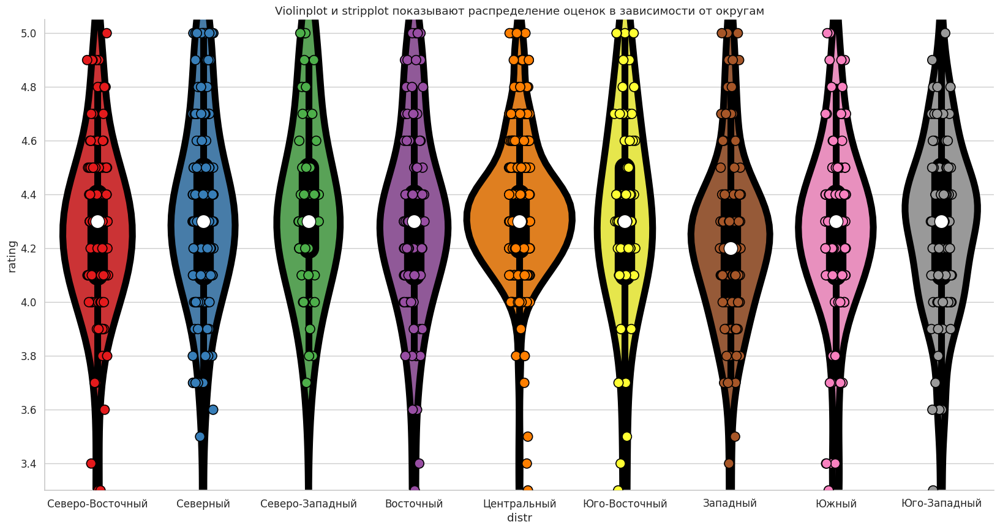

In [ ]:
sns.set_style('whitegrid')
plt.figure(figsize=(20, 10))
ax = sns.stripplot(x='distr', y='rating', data=coffee_data.sort_values(by='lat',ascending=False), jitter=0.1 ,
                   palette='Set1',edgecolor='black',linewidth=1.2, s = 11)
ax = sns.violinplot(x="distr", y="rating", data=coffee_data.sort_values(by='lat',ascending=False), color=".8",
    width=1,palette='Set1',linewidth=8,)

ax.tick_params(axis='x')
ax.set(ylim=(3.3, 5.05),
      title='Violinplot и stripplot показывают распределение оценок в зависимости от округам')
sns.despine()

In [ ]:
sns.set(font_scale=1.1)

(2.5, 5.18)

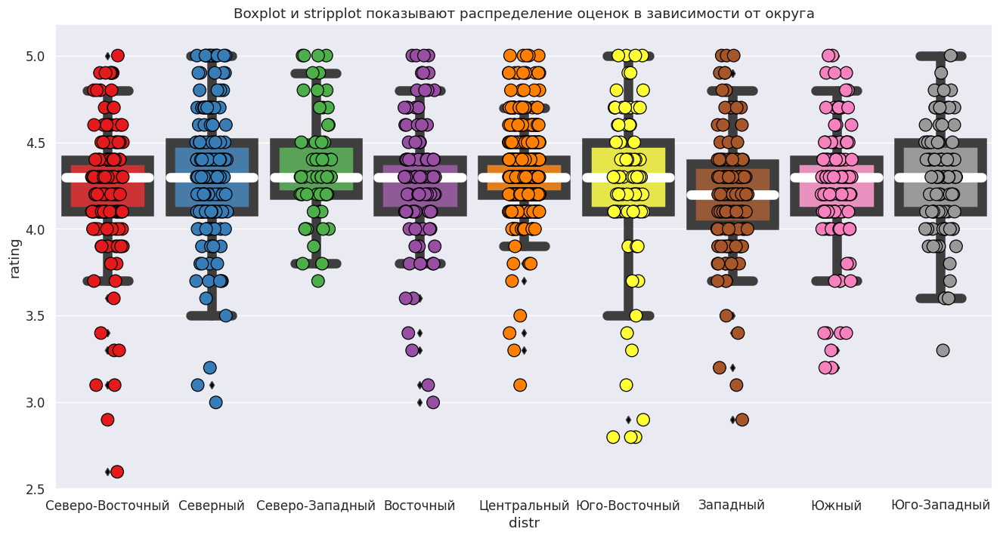

In [ ]:
plt.figure(figsize=(16, 8))
ax = sns.stripplot(x='distr', y='rating', data=coffee_data.sort_values(by='lat',ascending=False),jitter=0.15 ,
                   palette='Set1',edgecolor='black',linewidth=0.9, s = 12)
sns.boxplot(x="distr", y="rating",
            data=coffee_data.sort_values(by='lat',ascending=False), palette='Set1', linewidth=9,
            medianprops=dict(color="white", alpha=1),
            flierprops=dict(markerfacecolor="black"))
ax.set( title='Boxplot и stripplot показывают распределение оценок в зависимости от округа')
plt.ylim(2.5,)

In [ ]:
descr_coffee_data=pd.DataFrame(coffee_data['rating'].describe())
for x in coffee_data['district'].unique():
    descr_coffee_data[x]=coffee_data.loc[coffee_data['district']==x,'rating'].describe()
descr_coffee_data=round(descr_coffee_data.T,2)
descr_coffee_data

,count,mean,std,min,25%,50%,75%,max
rating,1413.0,4.28,0.37,1.4,4.10,4.3,4.40,5.0
Северный административный округ,193.0,4.29,0.44,2.0,4.10,4.3,4.50,5.0
Северо-Восточный административный округ,159.0,4.22,0.43,1.4,4.10,4.3,4.40,5.0
Северо-Западный административный округ,62.0,4.33,0.43,2.0,4.20,4.3,4.50,5.0
Центральный административный округ,428.0,4.34,0.26,2.3,4.20,4.3,4.40,5.0
Восточный административный округ,105.0,4.28,0.38,3.0,4.10,4.3,4.40,5.0
Западный административный округ,150.0,4.20,0.36,2.3,4.03,4.2,4.38,5.0
Юго-Восточный административный округ,89.0,4.23,0.51,2.3,4.10,4.3,4.50,5.0
Юго-Западный административный округ,96.0,4.28,0.30,3.3,4.10,4.3,4.50,5.0
Южный административный округ,131.0,4.23,0.39,2.0,4.10,4.3,4.40,5.0


**Вывод:   График выше показывает что оценки у кофеен в основном от 4 до 4.5. Ориентироваться стоит на эти цифры.**

### Выясним на какую стоимость чашки капучино стоит ориентироваться при открытии:

In [ ]:
print()
print('Выведем таблицу с основными статистиками цены чашки капучино:')
descr_ALL_coffee_data=pd.DataFrame(round(coffee_data.loc[coffee_data['middle_coffee_cup'].isna()==False,'middle_coffee_cup'].describe()))
descr_ALL_coffee_data


Выведем таблицу с основными статистиками цены чашки капучино:


,middle_coffee_cup
count,521.0
mean,175.0
std,90.0
min,60.0
25%,124.0
50%,170.0
75%,225.0
max,1568.0


In [ ]:
sns.set(font_scale=1.4)

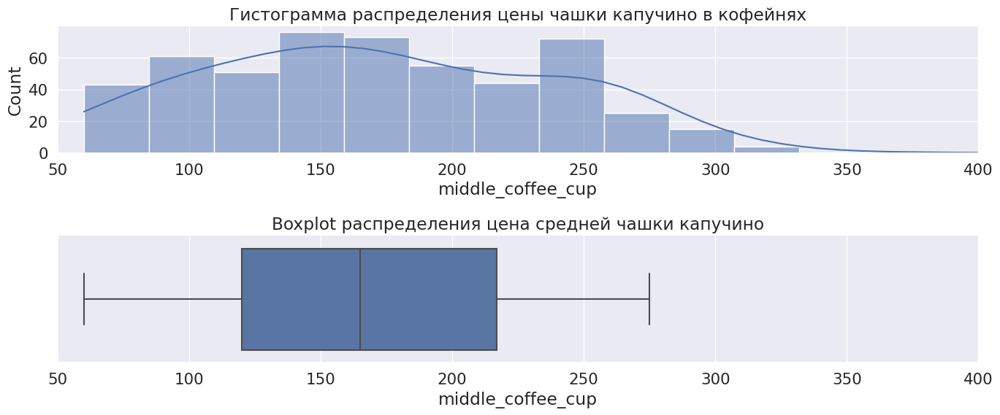

In [ ]:
plt.figure(figsize=(14,6))
ax=sns.histplot(data = coffee_data[coffee_data['middle_coffee_cup'].isna()==False],x='middle_coffee_cup',kde =True ,ax=plt.subplot(2,1,1))
ax.set(xlim=(50, 400),title='Гистограмма распределения цены чашки капучино в кофейнях')
ax=sns.boxplot(data = data_coffe_not_null,x='middle_coffee_cup',ax=plt.subplot(2,1,2))
ax.set(title='Boxplot распределения цена средней чашки капучино')
ax.set(xlim=(50, 400))
plt.tight_layout()
sns.despine()

In [ ]:
print()
print('При открытии кофейни следует ориентироватся на стоимость 1 чашки капучино начиная от'
      ,descr_ALL_coffee_data.loc['50%','middle_coffee_cup'].astype('int'),'до',
      descr_ALL_coffee_data.loc['mean','middle_coffee_cup'].astype('int'),
      'рублей.')
print('Эти числа обусловлены средней и медианной ценой чашки капучино в кофейнях по всей Москве.')


При открытии кофейни следует ориентироватся на стоимость 1 чашки капучино начиная от 170 до 175 рублей.
Эти числа обусловлены средней и медианной ценой чашки капучино в кофейнях по всей Москве.


**ВЫВОД:**

**В датасете всего 1413 кофеен.**

**30% из них располагаются в ЦАО. Карта hexbin и хороплет количества кофеен это подтверждают.**

**Круглосуточных кофеен всего 76 штук.**

**Средние оценки у кофеен в основном от 4 до 4.5. Кокретнее от 4.2 до 4.35.**

**При открытии кофейни следует ориентироваться на стоимость 1 чашки капучино начиная от 170 до 175 рублей.
Эти числа обусловлены средней и медианной ценой чашки капучино в кофейнях по всей Москве.**

## ВЫВОД:

**Анализ рынка общепита Москвы:**

Если сравнивать категории по посадочным местам то их больше всего в барах и пабах.

Количество сетевых заведений около 60%, а сетевых около 40%. Во всех случаях кроме пиццерий, кофеен и булочных количество несетевых заведений больше.

Из популярных сетевых заведений такие категории как кофейни, пиццерии, рестораны и кафе занимают около 95% от количетва всех заведений.

В датасете присутствуют 9 округов Москвы внутри МКАДа. По количеству заведений выделяется ЦАО. В нем окола 27% всех заведений датасета.

Средние оценки для всех категорий находятся в пределах 4-4,5. Можно сказать что оценки в категориях не сильно отличаются, но лидируют бары и пабы.
В среднем в центре ставят лучше оценки в (средняя - 4.38) по сравнениях с другими округами и оценки в среднем больше на 0.2.

Улицы на которых больше всего заведений:  Проспект мира, Профсоюзная, проспект Вернадского и Ленинский проспект. Причина тому их длинна.

Доля сетей на непопулярных улицах где есть всего одно заведение на 12% ниже чем доля сетей из общей выборки. Это явно говорит о присутствии как бы традиции или о большем отсутствии риска у менеджеров крупных компаний.

Расстояние слабо влияет на средний чек в заведении. Скорее всего это влияние обусловлено чем-то другим или целос рядом факторов.

**Анализ кофеен:**

30% из 1 413 кофеен датасета располагаются в ЦАО. Из них 76 круглосуточных. Средняя оценка будет от 4.2 до 4.35. А средняя цена 1 чашки капучино от 170 до 175 рублей.

При условии, что менеджеры и инвесторы "Shut Up and Take My Money" не боятся конкуренции и хотят что бы их кофейня была популярной и доступной, стоит открыть кофейню в ЦАО. Так у кофейня больше шансов получить хорошие оценки.

<div class="alert alert-success">
<b>Послесловие: </b>

Некоторые графики повторяются.
    
Можно было создать функцию для постоянного их построения. И с помощью этого повысить оптимизацию своего кода и презентабельность проекта в целом.
    
То есть мы можем создать "обёртки" с методами, и в функцию будем подавать нужные перменные:
    
- датасет
- подписи графика и осей
- и прочие любые настройки
    
</div>

# ПРЕЗЕНТАЦИЯ

Ссылка на презентацию PPTX и/или Google Презентации: https://docs.google.com/presentation/d/18qhPQiSW8G5TnlL94VzVmJhu9d2m-jBO7nAg3YfZzrc/edit?usp=sharing

Ссылка на презентацию PDF: https://drive.google.com/file/d/1TrghUz2nMEmEAdxtKl62Gtg0O5ODUNbm/view?usp=share_link